In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121

!pip install matplotlib numpy

Looking in indexes: https://download.pytorch.org/whl/cu121


In [3]:
!python --version

Python 3.10.12


In [4]:
import torch
torch.__version__

'2.5.1+cu121'

In [6]:
import os
import shutil

# Source directories
female_dir = '/kaggle/input/all-these-people-dont-exist/ThisPersonDoesNotExist/Female'
male_dir = '/kaggle/input/all-these-people-dont-exist/ThisPersonDoesNotExist/Male'

# Temporary destination directory
combined_dir = '/kaggle/working/combined_people'
os.makedirs(combined_dir, exist_ok=True)

# Function to copy files into the combined folder
def copy_images(src_folder, dest_folder):
    for filename in os.listdir(src_folder):
        src_path = os.path.join(src_folder, filename)
        dest_path = os.path.join(dest_folder, filename)
        if os.path.isfile(src_path):
            shutil.copy(src_path, dest_path)

# Copy from both folders
copy_images(female_dir, combined_dir)
copy_images(male_dir, combined_dir)

# Optional: List a few combined files to verify
print("Sample combined images:", os.listdir(combined_dir)[:5])


Sample combined images: ['20220902_163437_99468670377c4e76af70153a17f60229.png', '20220901_172631_9ebdb6a2861e4002be6ab93dbc8e6ffb.png', '20220902_164502_8ae23cf45155416e98678fb87b8f66da.png', '20220901_193718_c171c3e5c870476a9dce620c5b206ab4.png', '20220901_163115_198febb0f27846ccb6148d481152b88d.png']


In [11]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class CelebADataset(Dataset):
    def __init__(self, root_dir, transform=None):
        """
        Args:
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.root_dir = root_dir
        self.transform = transform
        
        # Get all image file paths from the directory
        self.image_paths = [os.path.join(root_dir, img) for img in os.listdir(root_dir) if img.endswith('.png')]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load image
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')
        
        # Apply the transform if provided
        if self.transform:
            image = self.transform(image)
        
        return image


In [12]:
import os

dataset_path = '/kaggle/working/combined_people'
images = [img for img in os.listdir(dataset_path) if img.endswith('.png')]
print(f"Total .jpg images found: {len(images)}")
print("Sample filenames:", images[:5])


Total .jpg images found: 6873
Sample filenames: ['20220902_163437_99468670377c4e76af70153a17f60229.png', '20220901_172631_9ebdb6a2861e4002be6ab93dbc8e6ffb.png', '20220902_164502_8ae23cf45155416e98678fb87b8f66da.png', '20220901_193718_c171c3e5c870476a9dce620c5b206ab4.png', '20220901_163115_198febb0f27846ccb6148d481152b88d.png']


In [13]:
# Define transformations (resize, crop, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize(64),  # Resize images to 64x64
    transforms.CenterCrop(64),  # Crop center to 64x64
    transforms.ToTensor(),  # Convert images to tensor
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalize to [-1, 1]
])

# Load CelebA dataset from the specified directory
dataset_path = '/kaggle/working/combined_people'
dataset = CelebADataset(root_dir=dataset_path, transform=transform)

# Create DataLoader
dataloader = DataLoader(dataset, batch_size=128, shuffle=True)

# Check how many images are loaded
print(f"Total number of images loaded: {len(dataset)}")


Total number of images loaded: 6873


[Epoch 0/10] [Batch 0/54] [D loss: 0.6975164413452148] [G loss: 0.697016716003418]
[Epoch 0/10] [Batch 50/54] [D loss: 0.3438704013824463] [G loss: 0.97568678855896]


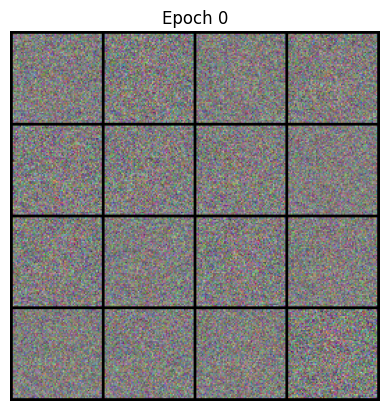

[Epoch 1/10] [Batch 0/54] [D loss: 0.24979886412620544] [G loss: 1.0442067384719849]
[Epoch 1/10] [Batch 50/54] [D loss: 0.34258002042770386] [G loss: 0.965960681438446]


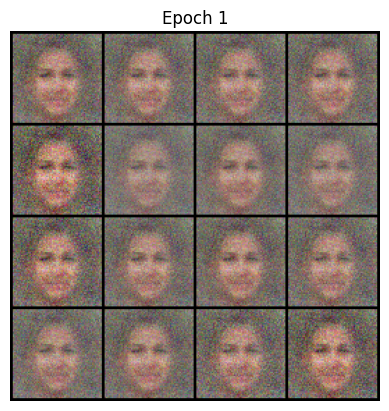

[Epoch 2/10] [Batch 0/54] [D loss: 0.39862483739852905] [G loss: 0.6633393168449402]
[Epoch 2/10] [Batch 50/54] [D loss: 0.2708093523979187] [G loss: 1.0781664848327637]


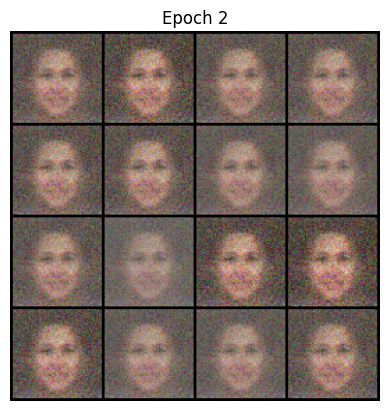

[Epoch 3/10] [Batch 0/54] [D loss: 0.27019646763801575] [G loss: 1.3152318000793457]
[Epoch 3/10] [Batch 50/54] [D loss: 0.2600075304508209] [G loss: 1.0634747743606567]
[Epoch 4/10] [Batch 0/54] [D loss: 0.2533112168312073] [G loss: 1.2148489952087402]
[Epoch 4/10] [Batch 50/54] [D loss: 0.19997556507587433] [G loss: 2.5276997089385986]


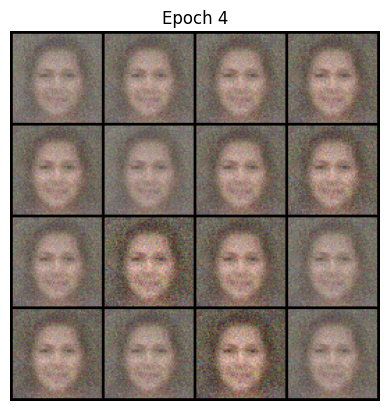

[Epoch 5/10] [Batch 0/54] [D loss: 0.28081434965133667] [G loss: 3.1362287998199463]
[Epoch 5/10] [Batch 50/54] [D loss: 0.09579314291477203] [G loss: 2.7118542194366455]


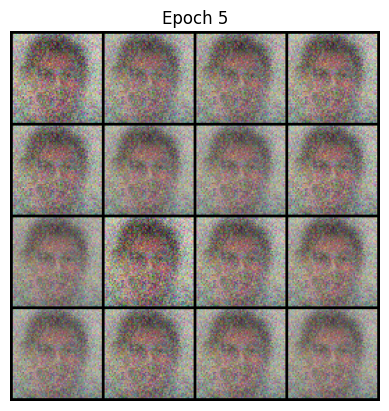

[Epoch 6/10] [Batch 0/54] [D loss: 0.07857398688793182] [G loss: 2.879817008972168]
[Epoch 6/10] [Batch 50/54] [D loss: 0.08618272840976715] [G loss: 2.121912956237793]


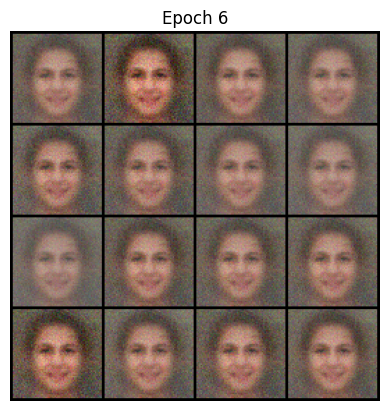

[Epoch 7/10] [Batch 0/54] [D loss: 0.11684300005435944] [G loss: 2.2701029777526855]
[Epoch 7/10] [Batch 50/54] [D loss: 0.2709888219833374] [G loss: 5.490542411804199]


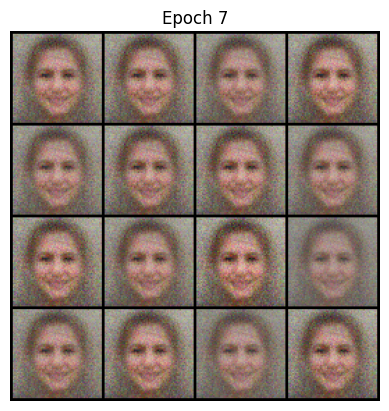

[Epoch 8/10] [Batch 0/54] [D loss: 0.2035161852836609] [G loss: 2.1057214736938477]
[Epoch 8/10] [Batch 50/54] [D loss: 0.160829558968544] [G loss: 3.178941249847412]


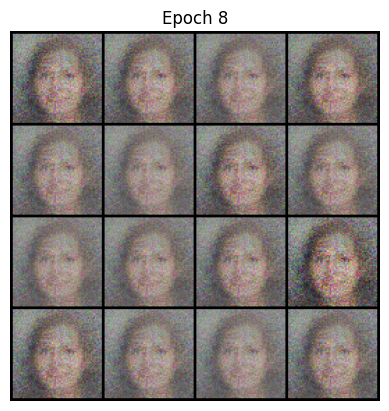

[Epoch 9/10] [Batch 0/54] [D loss: 0.041289787739515305] [G loss: 3.241764545440674]
[Epoch 9/10] [Batch 50/54] [D loss: 0.02653365582227707] [G loss: 4.716882228851318]


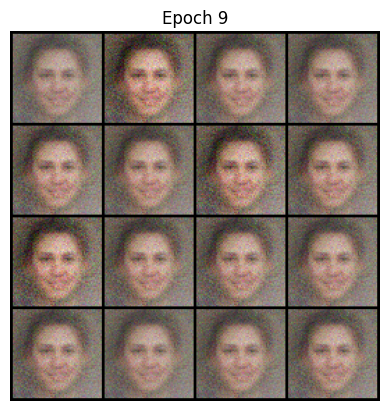

In [14]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms
import matplotlib.pyplot as plt
import os
from PIL import Image
import torchvision
import numpy as np


# Generator and Discriminator classes (same as previously described)
class Generator(nn.Module):
    def __init__(self, z_dim=100, img_channels=3):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(z_dim, 256),
            nn.ReLU(True),
            nn.Linear(256, 512),
            nn.ReLU(True),
            nn.Linear(512, 1024),
            nn.ReLU(True),
            nn.Linear(1024, img_channels * 64 * 64),
            nn.Tanh()
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(img.size(0), 3, 64, 64)  # Reshape to image format
        return img

class Discriminator(nn.Module):
    def __init__(self, img_channels=3):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Flatten(),
            nn.Linear(img_channels * 64 * 64, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img):
        return self.model(img)

# Loss function and optimizers
adversarial_loss = nn.BCELoss()
generator = Generator(z_dim=100)
discriminator = Discriminator()
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Define device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
generator = generator.to(device)
discriminator = discriminator.to(device)

# Training loop
def train(generator, discriminator, dataloader, epochs=5):
    for epoch in range(epochs):
        for i, imgs in enumerate(dataloader):
            real_imgs = imgs.to(device)
            batch_size = real_imgs.size(0)
            valid = torch.ones(batch_size, 1).to(device)
            fake = torch.zeros(batch_size, 1).to(device)

            # Train Discriminator
            optimizer_D.zero_grad()
            real_loss = adversarial_loss(discriminator(real_imgs), valid)
            fake_loss = adversarial_loss(discriminator(generator(torch.randn(batch_size, 100).to(device)).detach()), fake)
            d_loss = (real_loss + fake_loss) / 2
            d_loss.backward()
            optimizer_D.step()

            # Train Generator
            optimizer_G.zero_grad()
            g_loss = adversarial_loss(discriminator(generator(torch.randn(batch_size, 100).to(device))), valid)
            g_loss.backward()
            optimizer_G.step()

            if i % 50 == 0:
                print(f"[Epoch {epoch}/{epochs}] [Batch {i}/{len(dataloader)}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}]")

        # Optionally, save generated images at each epoch
        save_generated_images(generator, epoch, device)

def save_generated_images(generator, epoch, device, num_images=16):
    z = torch.randn(num_images, 100).to(device)
    generated_imgs = generator(z).detach().cpu()
    grid = torchvision.utils.make_grid(generated_imgs, nrow=4, normalize=True)
    plt.imshow(np.transpose(grid, (1, 2, 0)))
    plt.title(f"Epoch {epoch}")
    plt.axis('off')
    plt.show()

# Start training
train(generator, discriminator, dataloader, epochs=10)


In [16]:
generator = Generator().to(device)
discriminator = Discriminator().to(device)


[Epoch 0/50] [Batch 0/108] [D loss: 0.6951] [G loss: 0.6771]
[Epoch 0/50] [Batch 50/108] [D loss: 0.4109] [G loss: 0.6456]
[Epoch 0/50] [Batch 100/108] [D loss: 0.3600] [G loss: 0.8351]


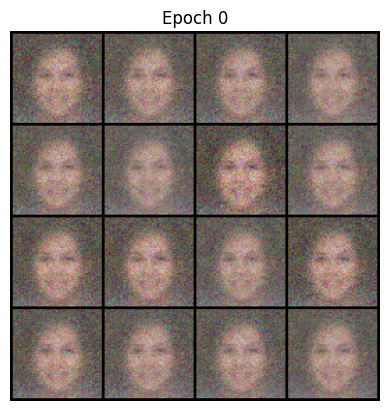

[Epoch 1/50] [Batch 0/108] [D loss: 0.3864] [G loss: 0.9072]
[Epoch 1/50] [Batch 50/108] [D loss: 0.9594] [G loss: 0.5032]
[Epoch 1/50] [Batch 100/108] [D loss: 0.1464] [G loss: 1.6370]


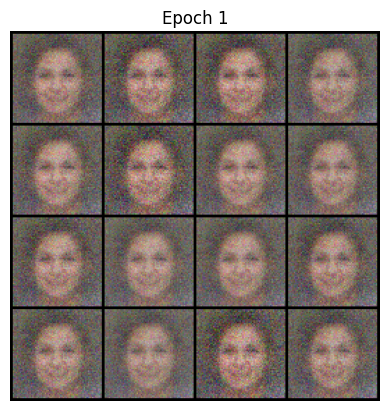

[Epoch 2/50] [Batch 0/108] [D loss: 0.1713] [G loss: 1.4101]
[Epoch 2/50] [Batch 50/108] [D loss: 0.2668] [G loss: 1.5378]
[Epoch 2/50] [Batch 100/108] [D loss: 0.1100] [G loss: 2.6714]


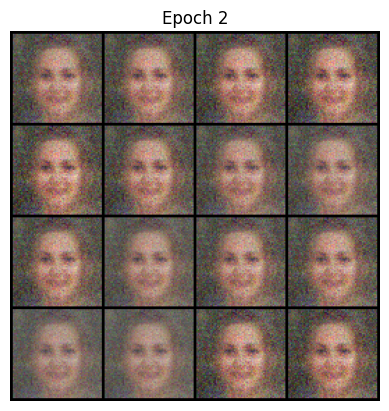

[Epoch 3/50] [Batch 0/108] [D loss: 0.6682] [G loss: 0.1659]
[Epoch 3/50] [Batch 50/108] [D loss: 0.0529] [G loss: 2.7710]
[Epoch 3/50] [Batch 100/108] [D loss: 0.0874] [G loss: 4.2549]


KeyboardInterrupt: 

In [18]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import matplotlib.pyplot as plt
import os
from PIL import Image
import torchvision
import numpy as np

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class Generator(nn.Module):
    def __init__(self, z_dim=100, img_channels=3):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(z_dim, 256),
            nn.ReLU(True),
            nn.Linear(256, 512),
            nn.ReLU(True),
            nn.Linear(512, 1024),
            nn.ReLU(True),
            nn.Linear(1024, img_channels * 64 * 64),
            nn.Tanh()
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(z.size(0), 3, 64, 64)
        return img

class Discriminator(nn.Module):
    def __init__(self, img_channels=3):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Flatten(),
            nn.Linear(img_channels * 64 * 64, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img):
        return self.model(img)

generator = Generator().to(device)
discriminator = Discriminator().to(device)

adversarial_loss = nn.BCELoss()
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

class CustomDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.image_paths = [os.path.join(root_dir, img) for img in os.listdir(root_dir) if img.endswith('.png') or img.endswith('.jpg')]
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img = Image.open(self.image_paths[idx]).convert('RGB')
        if self.transform:
            img = self.transform(img)
        return img

dataset = CustomDataset(root_dir="/kaggle/working/combined_people", transform=transform)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

def train(generator, discriminator, dataloader, epochs=5):
    for epoch in range(epochs):
        for i, imgs in enumerate(dataloader):
            real_imgs = imgs.to(device)
            batch_size = real_imgs.size(0)
            valid = torch.ones(batch_size, 1, device=device)
            fake = torch.zeros(batch_size, 1, device=device)

            optimizer_D.zero_grad()
            z = torch.randn(batch_size, 100, device=device)
            fake_imgs = generator(z).detach()
            real_loss = adversarial_loss(discriminator(real_imgs), valid)
            fake_loss = adversarial_loss(discriminator(fake_imgs), fake)
            d_loss = (real_loss + fake_loss) / 2
            d_loss.backward()
            optimizer_D.step()

            optimizer_G.zero_grad()
            z = torch.randn(batch_size, 100, device=device)
            gen_imgs = generator(z)
            g_loss = adversarial_loss(discriminator(gen_imgs), valid)
            g_loss.backward()
            optimizer_G.step()

            if i % 50 == 0:
                print(f"[Epoch {epoch}/{epochs}] [Batch {i}/{len(dataloader)}] [D loss: {d_loss.item():.4f}] [G loss: {g_loss.item():.4f}]")

        save_generated_images(generator, epoch)

def save_generated_images(generator, epoch, num_images=16):
    z = torch.randn(num_images, 100, device=device)
    generated_imgs = generator(z).detach().cpu()
    grid = torchvision.utils.make_grid(generated_imgs, nrow=4, normalize=True)
    plt.imshow(np.transpose(grid, (1, 2, 0)))
    plt.title(f"Epoch {epoch}")
    plt.axis('off')
    plt.show()

train(generator, discriminator, dataloader, epochs=50)


In [20]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os

class CelebADataset(Dataset):
    def __init__(self, root_dir, transform=None):
        """
        Args:
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.root_dir = root_dir
        self.transform = transform
        
        # Get all image file paths from the directory
        self.image_paths = [os.path.join(root_dir, img) for img in os.listdir(root_dir) if img.endswith('.jpg')]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load image
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert('RGB')
        
        # Apply the transform if provided
        if self.transform:
            image = self.transform(image)
        
        return image


[Epoch 0/50] [Batch 0/3166] [D loss: 0.6948] [G loss: 0.7097]
[Epoch 0/50] [Batch 50/3166] [D loss: 0.4496] [G loss: 0.6472]
[Epoch 0/50] [Batch 100/3166] [D loss: 0.3077] [G loss: 1.0634]
[Epoch 0/50] [Batch 150/3166] [D loss: 0.1868] [G loss: 1.2762]
[Epoch 0/50] [Batch 200/3166] [D loss: 0.0463] [G loss: 2.7158]
[Epoch 0/50] [Batch 250/3166] [D loss: 0.0531] [G loss: 2.8843]
[Epoch 0/50] [Batch 300/3166] [D loss: 0.0765] [G loss: 2.7033]
[Epoch 0/50] [Batch 350/3166] [D loss: 0.0203] [G loss: 3.8996]
[Epoch 0/50] [Batch 400/3166] [D loss: 0.0937] [G loss: 3.4839]
[Epoch 0/50] [Batch 450/3166] [D loss: 0.0265] [G loss: 4.4025]
[Epoch 0/50] [Batch 500/3166] [D loss: 0.0979] [G loss: 2.7640]
[Epoch 0/50] [Batch 550/3166] [D loss: 0.0582] [G loss: 2.5908]
[Epoch 0/50] [Batch 600/3166] [D loss: 0.0538] [G loss: 4.1864]
[Epoch 0/50] [Batch 650/3166] [D loss: 0.5758] [G loss: 3.4600]
[Epoch 0/50] [Batch 700/3166] [D loss: 0.0735] [G loss: 3.8334]
[Epoch 0/50] [Batch 750/3166] [D loss: 0.11

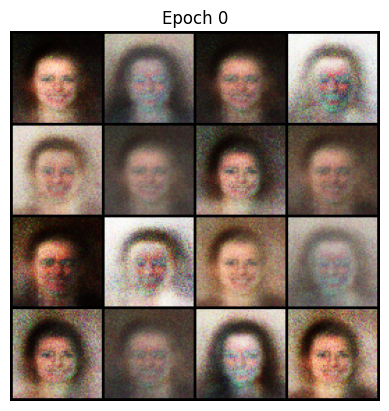

[Epoch 1/50] [Batch 0/3166] [D loss: 0.1983] [G loss: 2.8936]
[Epoch 1/50] [Batch 50/3166] [D loss: 0.1933] [G loss: 2.2750]
[Epoch 1/50] [Batch 100/3166] [D loss: 0.1577] [G loss: 3.5368]
[Epoch 1/50] [Batch 150/3166] [D loss: 0.2187] [G loss: 2.2899]
[Epoch 1/50] [Batch 200/3166] [D loss: 0.2570] [G loss: 3.1553]
[Epoch 1/50] [Batch 250/3166] [D loss: 0.2147] [G loss: 3.2800]
[Epoch 1/50] [Batch 300/3166] [D loss: 0.1810] [G loss: 3.3054]
[Epoch 1/50] [Batch 350/3166] [D loss: 0.3022] [G loss: 2.9557]
[Epoch 1/50] [Batch 400/3166] [D loss: 0.2884] [G loss: 3.6800]
[Epoch 1/50] [Batch 450/3166] [D loss: 0.2406] [G loss: 3.5793]
[Epoch 1/50] [Batch 500/3166] [D loss: 0.1845] [G loss: 3.9527]
[Epoch 1/50] [Batch 550/3166] [D loss: 0.1990] [G loss: 3.4645]
[Epoch 1/50] [Batch 600/3166] [D loss: 0.2803] [G loss: 2.3797]
[Epoch 1/50] [Batch 650/3166] [D loss: 0.3988] [G loss: 4.0567]
[Epoch 1/50] [Batch 700/3166] [D loss: 0.2371] [G loss: 3.8128]
[Epoch 1/50] [Batch 750/3166] [D loss: 0.33

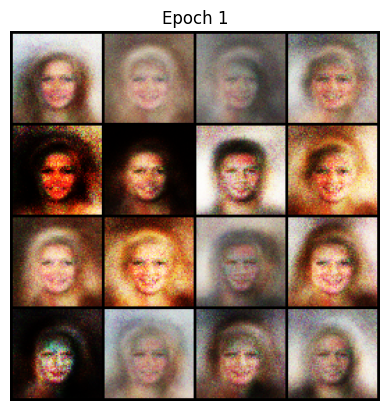

[Epoch 2/50] [Batch 0/3166] [D loss: 0.4228] [G loss: 1.9585]
[Epoch 2/50] [Batch 50/3166] [D loss: 0.6092] [G loss: 1.8954]
[Epoch 2/50] [Batch 100/3166] [D loss: 0.5195] [G loss: 1.8812]
[Epoch 2/50] [Batch 150/3166] [D loss: 0.4888] [G loss: 1.8230]
[Epoch 2/50] [Batch 200/3166] [D loss: 0.4269] [G loss: 1.3906]
[Epoch 2/50] [Batch 250/3166] [D loss: 0.3967] [G loss: 2.0961]
[Epoch 2/50] [Batch 300/3166] [D loss: 0.3897] [G loss: 2.0521]
[Epoch 2/50] [Batch 350/3166] [D loss: 0.4423] [G loss: 1.8420]
[Epoch 2/50] [Batch 400/3166] [D loss: 0.4384] [G loss: 1.9943]
[Epoch 2/50] [Batch 450/3166] [D loss: 0.4440] [G loss: 2.3158]
[Epoch 2/50] [Batch 500/3166] [D loss: 0.4532] [G loss: 1.9360]
[Epoch 2/50] [Batch 550/3166] [D loss: 0.5405] [G loss: 2.0835]
[Epoch 2/50] [Batch 600/3166] [D loss: 0.4224] [G loss: 1.3891]
[Epoch 2/50] [Batch 650/3166] [D loss: 0.4115] [G loss: 2.0751]
[Epoch 2/50] [Batch 700/3166] [D loss: 0.4130] [G loss: 2.5929]
[Epoch 2/50] [Batch 750/3166] [D loss: 0.41

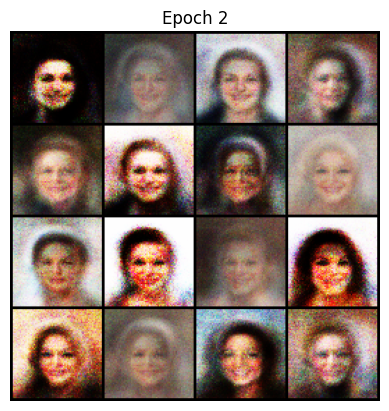

[Epoch 3/50] [Batch 0/3166] [D loss: 0.5281] [G loss: 1.4299]
[Epoch 3/50] [Batch 50/3166] [D loss: 0.4305] [G loss: 1.6082]
[Epoch 3/50] [Batch 100/3166] [D loss: 0.5554] [G loss: 1.4577]
[Epoch 3/50] [Batch 150/3166] [D loss: 0.4627] [G loss: 1.3079]
[Epoch 3/50] [Batch 200/3166] [D loss: 0.7393] [G loss: 1.4517]
[Epoch 3/50] [Batch 250/3166] [D loss: 0.4733] [G loss: 1.3937]
[Epoch 3/50] [Batch 300/3166] [D loss: 0.4609] [G loss: 1.5073]
[Epoch 3/50] [Batch 350/3166] [D loss: 0.4749] [G loss: 1.6425]
[Epoch 3/50] [Batch 400/3166] [D loss: 0.4699] [G loss: 1.4624]
[Epoch 3/50] [Batch 450/3166] [D loss: 0.4909] [G loss: 1.6078]
[Epoch 3/50] [Batch 500/3166] [D loss: 0.4836] [G loss: 1.6515]
[Epoch 3/50] [Batch 550/3166] [D loss: 0.5054] [G loss: 1.5534]
[Epoch 3/50] [Batch 600/3166] [D loss: 0.4876] [G loss: 1.5983]
[Epoch 3/50] [Batch 650/3166] [D loss: 0.4805] [G loss: 1.0754]
[Epoch 3/50] [Batch 700/3166] [D loss: 0.4342] [G loss: 1.5330]
[Epoch 3/50] [Batch 750/3166] [D loss: 0.55

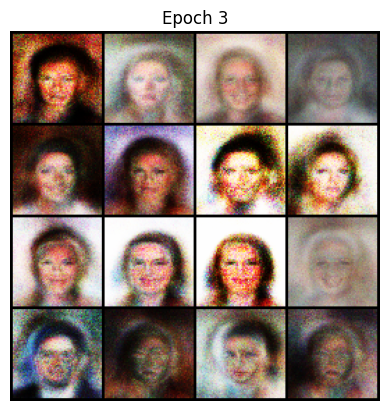

[Epoch 4/50] [Batch 0/3166] [D loss: 0.5393] [G loss: 1.2023]
[Epoch 4/50] [Batch 50/3166] [D loss: 0.5613] [G loss: 1.3740]
[Epoch 4/50] [Batch 100/3166] [D loss: 0.5022] [G loss: 1.1649]
[Epoch 4/50] [Batch 150/3166] [D loss: 0.4803] [G loss: 1.4541]
[Epoch 4/50] [Batch 200/3166] [D loss: 0.5856] [G loss: 1.5115]
[Epoch 4/50] [Batch 250/3166] [D loss: 0.5713] [G loss: 1.5906]
[Epoch 4/50] [Batch 300/3166] [D loss: 0.5791] [G loss: 1.4839]
[Epoch 4/50] [Batch 350/3166] [D loss: 0.5456] [G loss: 1.3307]
[Epoch 4/50] [Batch 400/3166] [D loss: 0.5190] [G loss: 1.3282]
[Epoch 4/50] [Batch 450/3166] [D loss: 0.5110] [G loss: 1.3051]
[Epoch 4/50] [Batch 500/3166] [D loss: 0.5193] [G loss: 1.4040]
[Epoch 4/50] [Batch 550/3166] [D loss: 0.4961] [G loss: 1.4772]
[Epoch 4/50] [Batch 600/3166] [D loss: 0.5535] [G loss: 1.6789]
[Epoch 4/50] [Batch 650/3166] [D loss: 0.5186] [G loss: 1.4282]
[Epoch 4/50] [Batch 700/3166] [D loss: 0.5340] [G loss: 1.3388]
[Epoch 4/50] [Batch 750/3166] [D loss: 0.69

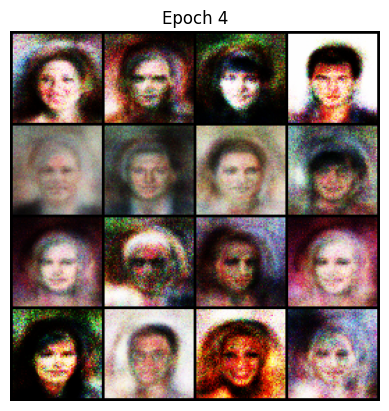

[Epoch 5/50] [Batch 0/3166] [D loss: 0.5605] [G loss: 1.3302]
[Epoch 5/50] [Batch 50/3166] [D loss: 0.6564] [G loss: 0.9479]
[Epoch 5/50] [Batch 100/3166] [D loss: 0.5852] [G loss: 1.2817]
[Epoch 5/50] [Batch 150/3166] [D loss: 0.4811] [G loss: 1.1636]
[Epoch 5/50] [Batch 200/3166] [D loss: 0.5364] [G loss: 1.2431]
[Epoch 5/50] [Batch 250/3166] [D loss: 0.6281] [G loss: 1.1297]
[Epoch 5/50] [Batch 300/3166] [D loss: 0.6274] [G loss: 1.2683]
[Epoch 5/50] [Batch 350/3166] [D loss: 0.6196] [G loss: 1.3521]
[Epoch 5/50] [Batch 400/3166] [D loss: 0.6186] [G loss: 1.0711]
[Epoch 5/50] [Batch 450/3166] [D loss: 0.5923] [G loss: 1.3581]
[Epoch 5/50] [Batch 500/3166] [D loss: 0.5726] [G loss: 1.1543]
[Epoch 5/50] [Batch 550/3166] [D loss: 0.6363] [G loss: 1.0908]
[Epoch 5/50] [Batch 600/3166] [D loss: 0.6132] [G loss: 1.3586]
[Epoch 5/50] [Batch 650/3166] [D loss: 0.5582] [G loss: 1.1845]
[Epoch 5/50] [Batch 700/3166] [D loss: 0.6353] [G loss: 1.2705]
[Epoch 5/50] [Batch 750/3166] [D loss: 0.53

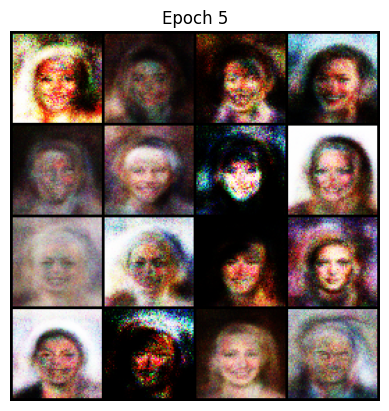

[Epoch 6/50] [Batch 0/3166] [D loss: 0.5890] [G loss: 1.0465]
[Epoch 6/50] [Batch 50/3166] [D loss: 0.5658] [G loss: 0.9489]
[Epoch 6/50] [Batch 100/3166] [D loss: 0.5871] [G loss: 1.1823]
[Epoch 6/50] [Batch 150/3166] [D loss: 0.6527] [G loss: 1.1226]
[Epoch 6/50] [Batch 200/3166] [D loss: 0.6257] [G loss: 1.2785]
[Epoch 6/50] [Batch 250/3166] [D loss: 0.6112] [G loss: 1.2019]
[Epoch 6/50] [Batch 300/3166] [D loss: 0.5357] [G loss: 0.9157]
[Epoch 6/50] [Batch 350/3166] [D loss: 0.6458] [G loss: 1.1445]
[Epoch 6/50] [Batch 400/3166] [D loss: 0.6175] [G loss: 1.0753]
[Epoch 6/50] [Batch 450/3166] [D loss: 0.6933] [G loss: 0.8927]
[Epoch 6/50] [Batch 500/3166] [D loss: 0.5523] [G loss: 0.9322]
[Epoch 6/50] [Batch 550/3166] [D loss: 0.5218] [G loss: 1.1935]
[Epoch 6/50] [Batch 600/3166] [D loss: 0.5574] [G loss: 1.1938]
[Epoch 6/50] [Batch 650/3166] [D loss: 0.6122] [G loss: 1.2233]
[Epoch 6/50] [Batch 700/3166] [D loss: 0.5418] [G loss: 1.1407]
[Epoch 6/50] [Batch 750/3166] [D loss: 0.66

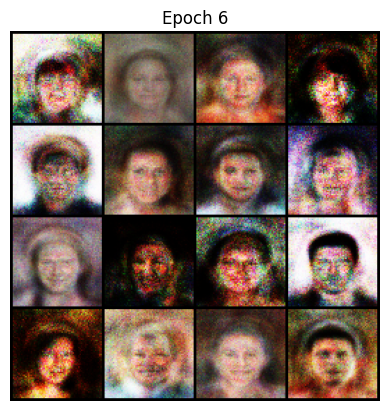

[Epoch 7/50] [Batch 0/3166] [D loss: 0.6723] [G loss: 0.9854]
[Epoch 7/50] [Batch 50/3166] [D loss: 0.5620] [G loss: 1.0997]
[Epoch 7/50] [Batch 100/3166] [D loss: 0.5777] [G loss: 0.9816]
[Epoch 7/50] [Batch 150/3166] [D loss: 0.5426] [G loss: 1.0314]
[Epoch 7/50] [Batch 200/3166] [D loss: 0.5930] [G loss: 1.0202]
[Epoch 7/50] [Batch 250/3166] [D loss: 0.6008] [G loss: 1.1871]
[Epoch 7/50] [Batch 300/3166] [D loss: 0.5251] [G loss: 1.0219]
[Epoch 7/50] [Batch 350/3166] [D loss: 0.6067] [G loss: 0.9354]
[Epoch 7/50] [Batch 400/3166] [D loss: 0.5758] [G loss: 1.0861]
[Epoch 7/50] [Batch 450/3166] [D loss: 0.5623] [G loss: 0.9584]
[Epoch 7/50] [Batch 500/3166] [D loss: 0.6369] [G loss: 1.0724]
[Epoch 7/50] [Batch 550/3166] [D loss: 0.5712] [G loss: 0.9263]
[Epoch 7/50] [Batch 600/3166] [D loss: 0.6458] [G loss: 1.1173]
[Epoch 7/50] [Batch 650/3166] [D loss: 0.5722] [G loss: 1.1064]
[Epoch 7/50] [Batch 700/3166] [D loss: 0.5877] [G loss: 0.9892]
[Epoch 7/50] [Batch 750/3166] [D loss: 0.66

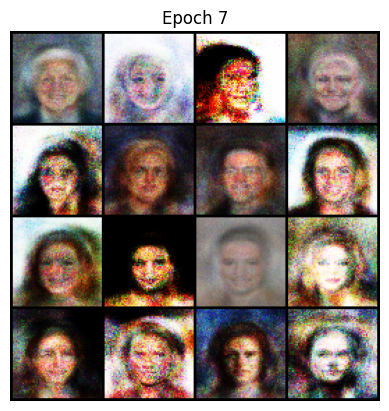

[Epoch 8/50] [Batch 0/3166] [D loss: 0.6244] [G loss: 0.8174]
[Epoch 8/50] [Batch 50/3166] [D loss: 0.5826] [G loss: 1.0784]
[Epoch 8/50] [Batch 100/3166] [D loss: 0.5707] [G loss: 0.9172]
[Epoch 8/50] [Batch 150/3166] [D loss: 0.6294] [G loss: 0.9718]
[Epoch 8/50] [Batch 200/3166] [D loss: 0.6069] [G loss: 1.0763]
[Epoch 8/50] [Batch 250/3166] [D loss: 0.6145] [G loss: 0.9765]
[Epoch 8/50] [Batch 300/3166] [D loss: 0.6362] [G loss: 1.0010]
[Epoch 8/50] [Batch 350/3166] [D loss: 0.6838] [G loss: 1.0990]
[Epoch 8/50] [Batch 400/3166] [D loss: 0.6342] [G loss: 0.8859]
[Epoch 8/50] [Batch 450/3166] [D loss: 0.6064] [G loss: 1.0639]
[Epoch 8/50] [Batch 500/3166] [D loss: 0.5740] [G loss: 0.9831]
[Epoch 8/50] [Batch 550/3166] [D loss: 0.6254] [G loss: 1.0484]
[Epoch 8/50] [Batch 600/3166] [D loss: 0.6122] [G loss: 0.8930]
[Epoch 8/50] [Batch 650/3166] [D loss: 0.6704] [G loss: 0.9167]
[Epoch 8/50] [Batch 700/3166] [D loss: 0.5962] [G loss: 1.1420]
[Epoch 8/50] [Batch 750/3166] [D loss: 0.71

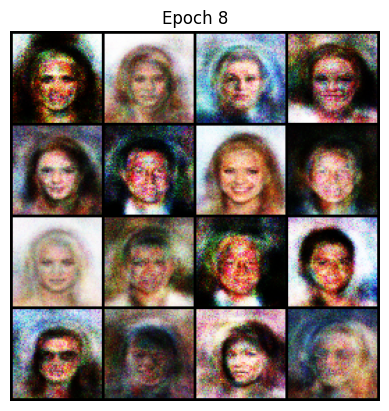

[Epoch 9/50] [Batch 0/3166] [D loss: 0.6288] [G loss: 0.9558]
[Epoch 9/50] [Batch 50/3166] [D loss: 0.5940] [G loss: 1.1019]
[Epoch 9/50] [Batch 100/3166] [D loss: 0.5953] [G loss: 0.9773]
[Epoch 9/50] [Batch 150/3166] [D loss: 0.6355] [G loss: 1.0010]
[Epoch 9/50] [Batch 200/3166] [D loss: 0.6317] [G loss: 0.9946]
[Epoch 9/50] [Batch 250/3166] [D loss: 0.6383] [G loss: 1.0028]
[Epoch 9/50] [Batch 300/3166] [D loss: 0.6101] [G loss: 1.0932]
[Epoch 9/50] [Batch 350/3166] [D loss: 0.6023] [G loss: 0.9580]
[Epoch 9/50] [Batch 400/3166] [D loss: 0.6714] [G loss: 0.9682]
[Epoch 9/50] [Batch 450/3166] [D loss: 0.6229] [G loss: 1.0051]
[Epoch 9/50] [Batch 500/3166] [D loss: 0.6177] [G loss: 0.9088]
[Epoch 9/50] [Batch 550/3166] [D loss: 0.6049] [G loss: 1.1730]
[Epoch 9/50] [Batch 600/3166] [D loss: 0.6019] [G loss: 1.0603]
[Epoch 9/50] [Batch 650/3166] [D loss: 0.5729] [G loss: 1.0413]
[Epoch 9/50] [Batch 700/3166] [D loss: 0.6137] [G loss: 0.9764]
[Epoch 9/50] [Batch 750/3166] [D loss: 0.58

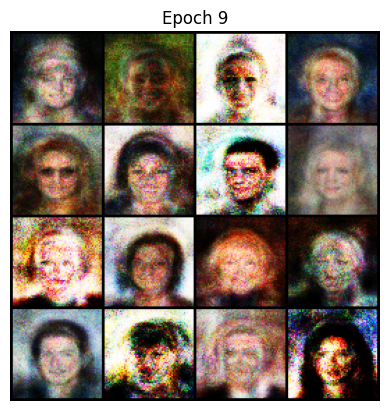

[Epoch 10/50] [Batch 0/3166] [D loss: 0.5577] [G loss: 0.9913]
[Epoch 10/50] [Batch 50/3166] [D loss: 0.5744] [G loss: 1.1036]
[Epoch 10/50] [Batch 100/3166] [D loss: 0.5540] [G loss: 0.9721]
[Epoch 10/50] [Batch 150/3166] [D loss: 0.5669] [G loss: 0.9974]
[Epoch 10/50] [Batch 200/3166] [D loss: 0.6072] [G loss: 1.0756]
[Epoch 10/50] [Batch 250/3166] [D loss: 0.6035] [G loss: 0.9767]
[Epoch 10/50] [Batch 300/3166] [D loss: 0.6624] [G loss: 1.1700]
[Epoch 10/50] [Batch 350/3166] [D loss: 0.5983] [G loss: 0.9201]
[Epoch 10/50] [Batch 400/3166] [D loss: 0.6176] [G loss: 1.0466]
[Epoch 10/50] [Batch 450/3166] [D loss: 0.6357] [G loss: 1.0652]
[Epoch 10/50] [Batch 500/3166] [D loss: 0.5629] [G loss: 0.9640]
[Epoch 10/50] [Batch 550/3166] [D loss: 0.5972] [G loss: 0.8533]
[Epoch 10/50] [Batch 600/3166] [D loss: 0.5888] [G loss: 0.9687]
[Epoch 10/50] [Batch 650/3166] [D loss: 0.6079] [G loss: 0.9429]
[Epoch 10/50] [Batch 700/3166] [D loss: 0.6145] [G loss: 1.1332]
[Epoch 10/50] [Batch 750/316

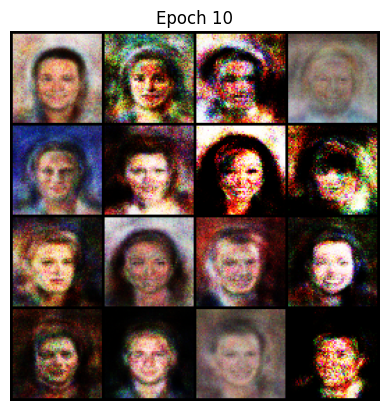

[Epoch 11/50] [Batch 0/3166] [D loss: 0.5940] [G loss: 1.0069]
[Epoch 11/50] [Batch 50/3166] [D loss: 0.6507] [G loss: 0.9845]
[Epoch 11/50] [Batch 100/3166] [D loss: 0.5786] [G loss: 1.1097]
[Epoch 11/50] [Batch 150/3166] [D loss: 0.6347] [G loss: 1.0007]
[Epoch 11/50] [Batch 200/3166] [D loss: 0.5402] [G loss: 1.0236]
[Epoch 11/50] [Batch 250/3166] [D loss: 0.6484] [G loss: 0.9376]
[Epoch 11/50] [Batch 300/3166] [D loss: 0.6010] [G loss: 1.0528]
[Epoch 11/50] [Batch 350/3166] [D loss: 0.5533] [G loss: 0.9665]
[Epoch 11/50] [Batch 400/3166] [D loss: 0.6282] [G loss: 1.0425]
[Epoch 11/50] [Batch 450/3166] [D loss: 0.5810] [G loss: 0.9311]
[Epoch 11/50] [Batch 500/3166] [D loss: 0.6234] [G loss: 0.9070]
[Epoch 11/50] [Batch 550/3166] [D loss: 0.6155] [G loss: 1.0084]
[Epoch 11/50] [Batch 600/3166] [D loss: 0.6076] [G loss: 0.9078]
[Epoch 11/50] [Batch 650/3166] [D loss: 0.6174] [G loss: 0.9985]
[Epoch 11/50] [Batch 700/3166] [D loss: 0.6302] [G loss: 1.2025]
[Epoch 11/50] [Batch 750/316

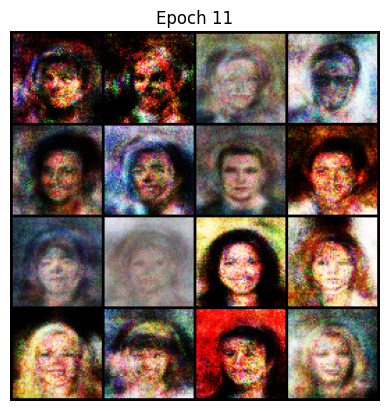

[Epoch 12/50] [Batch 0/3166] [D loss: 0.6299] [G loss: 1.0564]
[Epoch 12/50] [Batch 50/3166] [D loss: 0.5676] [G loss: 1.0861]
[Epoch 12/50] [Batch 100/3166] [D loss: 0.5823] [G loss: 1.0292]
[Epoch 12/50] [Batch 150/3166] [D loss: 0.6083] [G loss: 0.9772]
[Epoch 12/50] [Batch 200/3166] [D loss: 0.5826] [G loss: 0.9719]
[Epoch 12/50] [Batch 250/3166] [D loss: 0.6675] [G loss: 0.9550]
[Epoch 12/50] [Batch 300/3166] [D loss: 0.6303] [G loss: 0.8983]
[Epoch 12/50] [Batch 350/3166] [D loss: 0.6177] [G loss: 0.8738]
[Epoch 12/50] [Batch 400/3166] [D loss: 0.5880] [G loss: 0.9713]
[Epoch 12/50] [Batch 450/3166] [D loss: 0.5578] [G loss: 1.0801]
[Epoch 12/50] [Batch 500/3166] [D loss: 0.6019] [G loss: 1.1098]
[Epoch 12/50] [Batch 550/3166] [D loss: 0.6059] [G loss: 0.8940]
[Epoch 12/50] [Batch 600/3166] [D loss: 0.6394] [G loss: 1.1034]
[Epoch 12/50] [Batch 650/3166] [D loss: 0.6034] [G loss: 0.8991]
[Epoch 12/50] [Batch 700/3166] [D loss: 0.6178] [G loss: 1.0324]
[Epoch 12/50] [Batch 750/316

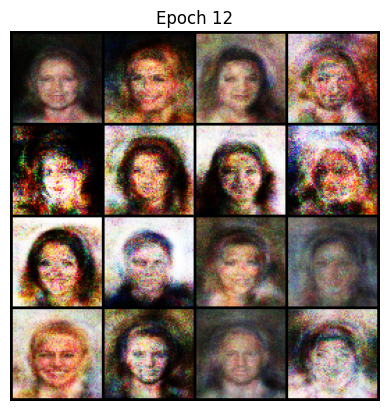

[Epoch 13/50] [Batch 0/3166] [D loss: 0.6515] [G loss: 1.0018]
[Epoch 13/50] [Batch 50/3166] [D loss: 0.6017] [G loss: 1.0304]
[Epoch 13/50] [Batch 100/3166] [D loss: 0.5839] [G loss: 1.0175]
[Epoch 13/50] [Batch 150/3166] [D loss: 0.5657] [G loss: 1.0226]
[Epoch 13/50] [Batch 200/3166] [D loss: 0.6612] [G loss: 1.0681]
[Epoch 13/50] [Batch 250/3166] [D loss: 0.6792] [G loss: 1.1755]
[Epoch 13/50] [Batch 300/3166] [D loss: 0.5724] [G loss: 1.1634]
[Epoch 13/50] [Batch 350/3166] [D loss: 0.6304] [G loss: 1.1611]
[Epoch 13/50] [Batch 400/3166] [D loss: 0.7004] [G loss: 1.0018]
[Epoch 13/50] [Batch 450/3166] [D loss: 0.5876] [G loss: 0.9901]
[Epoch 13/50] [Batch 500/3166] [D loss: 0.5593] [G loss: 0.9526]
[Epoch 13/50] [Batch 550/3166] [D loss: 0.5533] [G loss: 0.9951]
[Epoch 13/50] [Batch 600/3166] [D loss: 0.5912] [G loss: 1.1330]
[Epoch 13/50] [Batch 650/3166] [D loss: 0.5974] [G loss: 1.1046]
[Epoch 13/50] [Batch 700/3166] [D loss: 0.6159] [G loss: 1.0966]
[Epoch 13/50] [Batch 750/316

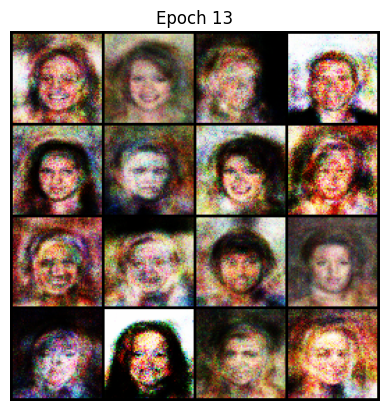

[Epoch 14/50] [Batch 0/3166] [D loss: 0.6648] [G loss: 1.1933]
[Epoch 14/50] [Batch 50/3166] [D loss: 0.5746] [G loss: 1.0421]
[Epoch 14/50] [Batch 100/3166] [D loss: 0.5959] [G loss: 1.0138]
[Epoch 14/50] [Batch 150/3166] [D loss: 0.6136] [G loss: 1.0757]
[Epoch 14/50] [Batch 200/3166] [D loss: 0.5916] [G loss: 1.0528]
[Epoch 14/50] [Batch 250/3166] [D loss: 0.6408] [G loss: 1.1193]
[Epoch 14/50] [Batch 300/3166] [D loss: 0.6433] [G loss: 0.9753]
[Epoch 14/50] [Batch 350/3166] [D loss: 0.6175] [G loss: 1.2795]
[Epoch 14/50] [Batch 400/3166] [D loss: 0.6022] [G loss: 0.9723]
[Epoch 14/50] [Batch 450/3166] [D loss: 0.5975] [G loss: 1.0279]
[Epoch 14/50] [Batch 500/3166] [D loss: 0.6256] [G loss: 1.1125]
[Epoch 14/50] [Batch 550/3166] [D loss: 0.6425] [G loss: 1.0278]
[Epoch 14/50] [Batch 600/3166] [D loss: 0.6290] [G loss: 1.1636]
[Epoch 14/50] [Batch 650/3166] [D loss: 0.5509] [G loss: 1.0713]
[Epoch 14/50] [Batch 700/3166] [D loss: 0.5653] [G loss: 0.9324]
[Epoch 14/50] [Batch 750/316

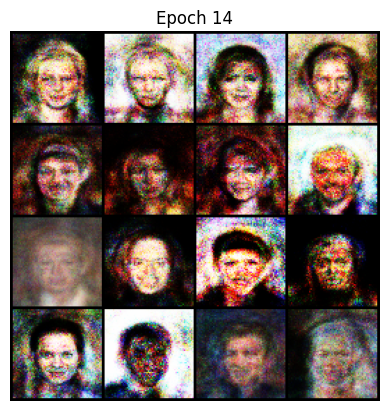

[Epoch 15/50] [Batch 0/3166] [D loss: 0.6032] [G loss: 0.8846]
[Epoch 15/50] [Batch 50/3166] [D loss: 0.5749] [G loss: 0.9780]
[Epoch 15/50] [Batch 100/3166] [D loss: 0.6140] [G loss: 1.1561]
[Epoch 15/50] [Batch 150/3166] [D loss: 0.5698] [G loss: 0.9277]
[Epoch 15/50] [Batch 200/3166] [D loss: 0.6427] [G loss: 1.0663]
[Epoch 15/50] [Batch 250/3166] [D loss: 0.6604] [G loss: 1.0720]
[Epoch 15/50] [Batch 300/3166] [D loss: 0.6351] [G loss: 0.9802]
[Epoch 15/50] [Batch 350/3166] [D loss: 0.6019] [G loss: 0.9160]
[Epoch 15/50] [Batch 400/3166] [D loss: 0.6249] [G loss: 1.0801]
[Epoch 15/50] [Batch 450/3166] [D loss: 0.5275] [G loss: 1.0741]
[Epoch 15/50] [Batch 500/3166] [D loss: 0.5923] [G loss: 1.0833]
[Epoch 15/50] [Batch 550/3166] [D loss: 0.6325] [G loss: 1.0500]
[Epoch 15/50] [Batch 600/3166] [D loss: 0.6000] [G loss: 1.0263]
[Epoch 15/50] [Batch 650/3166] [D loss: 0.6235] [G loss: 1.0737]
[Epoch 15/50] [Batch 700/3166] [D loss: 0.6168] [G loss: 0.9633]
[Epoch 15/50] [Batch 750/316

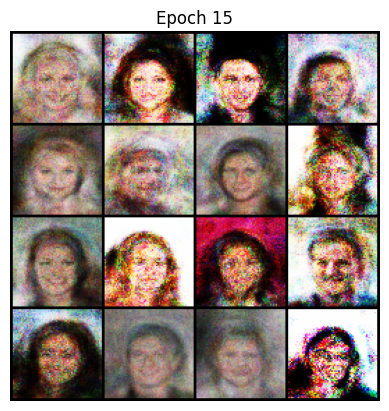

[Epoch 16/50] [Batch 0/3166] [D loss: 0.6206] [G loss: 1.1155]
[Epoch 16/50] [Batch 50/3166] [D loss: 0.6004] [G loss: 1.0800]
[Epoch 16/50] [Batch 100/3166] [D loss: 0.5916] [G loss: 0.8236]
[Epoch 16/50] [Batch 150/3166] [D loss: 0.5554] [G loss: 1.1430]
[Epoch 16/50] [Batch 200/3166] [D loss: 0.6553] [G loss: 1.1943]
[Epoch 16/50] [Batch 250/3166] [D loss: 0.5992] [G loss: 1.0883]
[Epoch 16/50] [Batch 300/3166] [D loss: 0.6205] [G loss: 1.0636]
[Epoch 16/50] [Batch 350/3166] [D loss: 0.6226] [G loss: 0.9906]
[Epoch 16/50] [Batch 400/3166] [D loss: 0.5879] [G loss: 1.0916]
[Epoch 16/50] [Batch 450/3166] [D loss: 0.5972] [G loss: 1.0259]
[Epoch 16/50] [Batch 500/3166] [D loss: 0.5850] [G loss: 1.0277]
[Epoch 16/50] [Batch 550/3166] [D loss: 0.5935] [G loss: 1.2036]
[Epoch 16/50] [Batch 600/3166] [D loss: 0.6240] [G loss: 1.0739]
[Epoch 16/50] [Batch 650/3166] [D loss: 0.5939] [G loss: 1.2150]
[Epoch 16/50] [Batch 700/3166] [D loss: 0.5796] [G loss: 1.1156]
[Epoch 16/50] [Batch 750/316

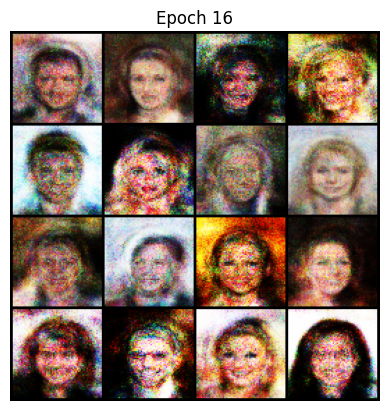

[Epoch 17/50] [Batch 0/3166] [D loss: 0.5593] [G loss: 0.9168]
[Epoch 17/50] [Batch 50/3166] [D loss: 0.6402] [G loss: 1.0124]
[Epoch 17/50] [Batch 100/3166] [D loss: 0.5495] [G loss: 1.1035]
[Epoch 17/50] [Batch 150/3166] [D loss: 0.6113] [G loss: 1.0535]
[Epoch 17/50] [Batch 200/3166] [D loss: 0.5668] [G loss: 1.2404]
[Epoch 17/50] [Batch 250/3166] [D loss: 0.5568] [G loss: 0.9651]
[Epoch 17/50] [Batch 300/3166] [D loss: 0.6288] [G loss: 1.0388]
[Epoch 17/50] [Batch 350/3166] [D loss: 0.5841] [G loss: 1.1452]
[Epoch 17/50] [Batch 400/3166] [D loss: 0.5891] [G loss: 1.2317]
[Epoch 17/50] [Batch 450/3166] [D loss: 0.6065] [G loss: 1.1073]
[Epoch 17/50] [Batch 500/3166] [D loss: 0.6395] [G loss: 1.0332]
[Epoch 17/50] [Batch 550/3166] [D loss: 0.6055] [G loss: 1.0038]
[Epoch 17/50] [Batch 600/3166] [D loss: 0.5672] [G loss: 1.1677]
[Epoch 17/50] [Batch 650/3166] [D loss: 0.6021] [G loss: 1.1177]
[Epoch 17/50] [Batch 700/3166] [D loss: 0.6314] [G loss: 1.1522]
[Epoch 17/50] [Batch 750/316

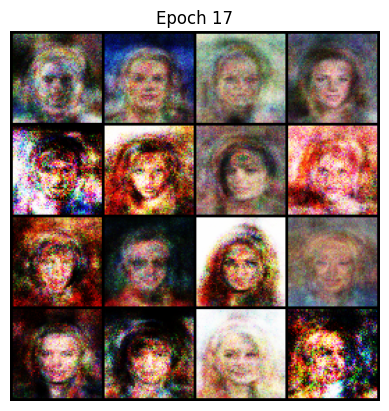

[Epoch 18/50] [Batch 0/3166] [D loss: 0.5801] [G loss: 1.1564]
[Epoch 18/50] [Batch 50/3166] [D loss: 0.5827] [G loss: 1.1473]
[Epoch 18/50] [Batch 100/3166] [D loss: 0.6317] [G loss: 1.0050]
[Epoch 18/50] [Batch 150/3166] [D loss: 0.5680] [G loss: 0.9670]
[Epoch 18/50] [Batch 200/3166] [D loss: 0.5973] [G loss: 1.0732]
[Epoch 18/50] [Batch 250/3166] [D loss: 0.6109] [G loss: 1.1370]
[Epoch 18/50] [Batch 300/3166] [D loss: 0.5280] [G loss: 1.0431]
[Epoch 18/50] [Batch 350/3166] [D loss: 0.5612] [G loss: 1.0700]
[Epoch 18/50] [Batch 400/3166] [D loss: 0.5706] [G loss: 1.2491]
[Epoch 18/50] [Batch 450/3166] [D loss: 0.5143] [G loss: 1.2184]
[Epoch 18/50] [Batch 500/3166] [D loss: 0.6353] [G loss: 1.0105]
[Epoch 18/50] [Batch 550/3166] [D loss: 0.6362] [G loss: 0.9739]
[Epoch 18/50] [Batch 600/3166] [D loss: 0.5492] [G loss: 1.1543]
[Epoch 18/50] [Batch 650/3166] [D loss: 0.6270] [G loss: 1.0378]
[Epoch 18/50] [Batch 700/3166] [D loss: 0.5982] [G loss: 1.0855]
[Epoch 18/50] [Batch 750/316

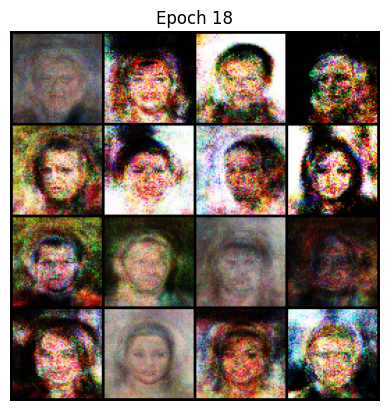

[Epoch 19/50] [Batch 0/3166] [D loss: 0.6164] [G loss: 0.9852]
[Epoch 19/50] [Batch 50/3166] [D loss: 0.5612] [G loss: 1.0909]
[Epoch 19/50] [Batch 100/3166] [D loss: 0.5842] [G loss: 0.9436]
[Epoch 19/50] [Batch 150/3166] [D loss: 0.6012] [G loss: 1.0592]
[Epoch 19/50] [Batch 200/3166] [D loss: 0.5542] [G loss: 0.9905]
[Epoch 19/50] [Batch 250/3166] [D loss: 0.6355] [G loss: 1.1615]
[Epoch 19/50] [Batch 300/3166] [D loss: 0.6189] [G loss: 1.0488]
[Epoch 19/50] [Batch 350/3166] [D loss: 0.5530] [G loss: 1.4153]
[Epoch 19/50] [Batch 400/3166] [D loss: 0.5376] [G loss: 1.0855]
[Epoch 19/50] [Batch 450/3166] [D loss: 0.6064] [G loss: 1.1460]
[Epoch 19/50] [Batch 500/3166] [D loss: 0.5786] [G loss: 1.1969]
[Epoch 19/50] [Batch 550/3166] [D loss: 0.6472] [G loss: 1.2447]
[Epoch 19/50] [Batch 600/3166] [D loss: 0.6772] [G loss: 1.3042]
[Epoch 19/50] [Batch 650/3166] [D loss: 0.5849] [G loss: 0.8840]
[Epoch 19/50] [Batch 700/3166] [D loss: 0.6243] [G loss: 1.1899]
[Epoch 19/50] [Batch 750/316

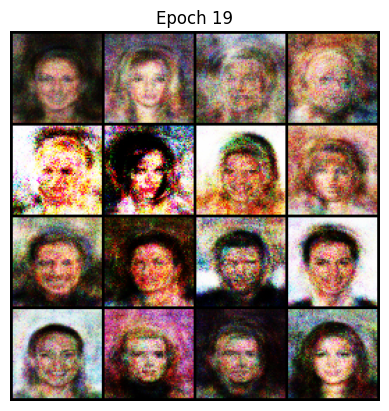

[Epoch 20/50] [Batch 0/3166] [D loss: 0.6466] [G loss: 1.1535]
[Epoch 20/50] [Batch 50/3166] [D loss: 0.6557] [G loss: 1.0267]
[Epoch 20/50] [Batch 100/3166] [D loss: 0.6003] [G loss: 1.2294]
[Epoch 20/50] [Batch 150/3166] [D loss: 0.5726] [G loss: 1.3022]
[Epoch 20/50] [Batch 200/3166] [D loss: 0.6234] [G loss: 1.3531]
[Epoch 20/50] [Batch 250/3166] [D loss: 0.5650] [G loss: 1.1159]
[Epoch 20/50] [Batch 300/3166] [D loss: 0.6090] [G loss: 1.0053]
[Epoch 20/50] [Batch 350/3166] [D loss: 0.5761] [G loss: 1.0187]
[Epoch 20/50] [Batch 400/3166] [D loss: 0.5955] [G loss: 1.0668]
[Epoch 20/50] [Batch 450/3166] [D loss: 0.5459] [G loss: 1.0720]
[Epoch 20/50] [Batch 500/3166] [D loss: 0.6008] [G loss: 1.2759]
[Epoch 20/50] [Batch 550/3166] [D loss: 0.6186] [G loss: 1.2469]
[Epoch 20/50] [Batch 600/3166] [D loss: 0.5846] [G loss: 1.2672]
[Epoch 20/50] [Batch 650/3166] [D loss: 0.6001] [G loss: 1.2078]
[Epoch 20/50] [Batch 700/3166] [D loss: 0.6496] [G loss: 1.0890]
[Epoch 20/50] [Batch 750/316

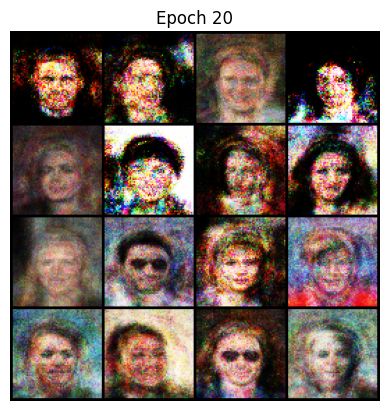

[Epoch 21/50] [Batch 0/3166] [D loss: 0.6134] [G loss: 1.0657]
[Epoch 21/50] [Batch 50/3166] [D loss: 0.6426] [G loss: 1.1207]
[Epoch 21/50] [Batch 100/3166] [D loss: 0.5441] [G loss: 1.1943]
[Epoch 21/50] [Batch 150/3166] [D loss: 0.5902] [G loss: 1.2355]
[Epoch 21/50] [Batch 200/3166] [D loss: 0.5292] [G loss: 1.0571]
[Epoch 21/50] [Batch 250/3166] [D loss: 0.5526] [G loss: 1.0609]
[Epoch 21/50] [Batch 300/3166] [D loss: 0.5862] [G loss: 1.1308]
[Epoch 21/50] [Batch 350/3166] [D loss: 0.6010] [G loss: 1.1172]
[Epoch 21/50] [Batch 400/3166] [D loss: 0.5911] [G loss: 1.0494]
[Epoch 21/50] [Batch 450/3166] [D loss: 0.5577] [G loss: 1.1467]
[Epoch 21/50] [Batch 500/3166] [D loss: 0.5249] [G loss: 1.1846]
[Epoch 21/50] [Batch 550/3166] [D loss: 0.5436] [G loss: 0.9833]
[Epoch 21/50] [Batch 600/3166] [D loss: 0.6167] [G loss: 1.1136]
[Epoch 21/50] [Batch 650/3166] [D loss: 0.5519] [G loss: 1.0093]
[Epoch 21/50] [Batch 700/3166] [D loss: 0.6597] [G loss: 1.0165]
[Epoch 21/50] [Batch 750/316

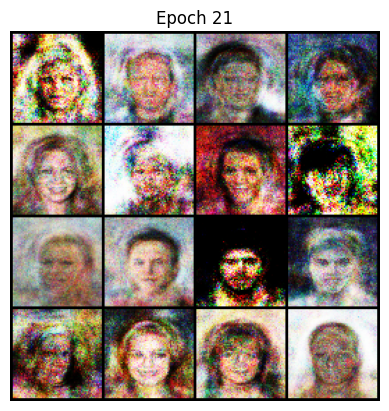

[Epoch 22/50] [Batch 0/3166] [D loss: 0.5763] [G loss: 1.0495]
[Epoch 22/50] [Batch 50/3166] [D loss: 0.5784] [G loss: 1.1322]
[Epoch 22/50] [Batch 100/3166] [D loss: 0.6047] [G loss: 1.1860]
[Epoch 22/50] [Batch 150/3166] [D loss: 0.6719] [G loss: 0.9149]
[Epoch 22/50] [Batch 200/3166] [D loss: 0.5132] [G loss: 1.1803]
[Epoch 22/50] [Batch 250/3166] [D loss: 0.5143] [G loss: 1.0470]
[Epoch 22/50] [Batch 300/3166] [D loss: 0.5605] [G loss: 1.1527]
[Epoch 22/50] [Batch 350/3166] [D loss: 0.6428] [G loss: 1.3174]
[Epoch 22/50] [Batch 400/3166] [D loss: 0.5778] [G loss: 1.1134]
[Epoch 22/50] [Batch 450/3166] [D loss: 0.6068] [G loss: 1.1385]
[Epoch 22/50] [Batch 500/3166] [D loss: 0.5394] [G loss: 1.0992]
[Epoch 22/50] [Batch 550/3166] [D loss: 0.6080] [G loss: 1.0034]
[Epoch 22/50] [Batch 600/3166] [D loss: 0.5613] [G loss: 1.0208]
[Epoch 22/50] [Batch 650/3166] [D loss: 0.5558] [G loss: 1.0977]
[Epoch 22/50] [Batch 700/3166] [D loss: 0.5609] [G loss: 1.2717]
[Epoch 22/50] [Batch 750/316

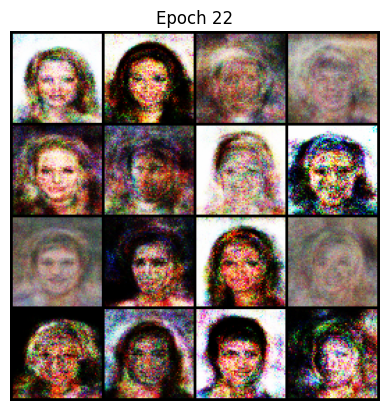

[Epoch 23/50] [Batch 0/3166] [D loss: 0.5518] [G loss: 1.1267]
[Epoch 23/50] [Batch 50/3166] [D loss: 0.5739] [G loss: 1.2934]
[Epoch 23/50] [Batch 100/3166] [D loss: 0.6002] [G loss: 1.2585]
[Epoch 23/50] [Batch 150/3166] [D loss: 0.5980] [G loss: 1.3657]
[Epoch 23/50] [Batch 200/3166] [D loss: 0.5832] [G loss: 0.9766]
[Epoch 23/50] [Batch 250/3166] [D loss: 0.5572] [G loss: 1.0602]
[Epoch 23/50] [Batch 300/3166] [D loss: 0.5306] [G loss: 1.1338]
[Epoch 23/50] [Batch 350/3166] [D loss: 0.6401] [G loss: 1.2909]
[Epoch 23/50] [Batch 400/3166] [D loss: 0.5953] [G loss: 1.1936]
[Epoch 23/50] [Batch 450/3166] [D loss: 0.5697] [G loss: 1.0651]
[Epoch 23/50] [Batch 500/3166] [D loss: 0.5510] [G loss: 1.2523]
[Epoch 23/50] [Batch 550/3166] [D loss: 0.6425] [G loss: 1.2581]
[Epoch 23/50] [Batch 600/3166] [D loss: 0.5275] [G loss: 0.9657]
[Epoch 23/50] [Batch 650/3166] [D loss: 0.5894] [G loss: 1.0030]
[Epoch 23/50] [Batch 700/3166] [D loss: 0.5035] [G loss: 1.2745]
[Epoch 23/50] [Batch 750/316

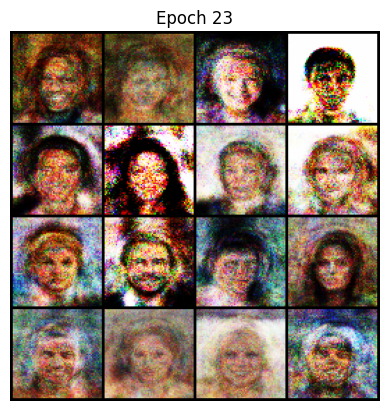

[Epoch 24/50] [Batch 0/3166] [D loss: 0.4828] [G loss: 1.1063]
[Epoch 24/50] [Batch 50/3166] [D loss: 0.5829] [G loss: 1.3056]
[Epoch 24/50] [Batch 100/3166] [D loss: 0.5665] [G loss: 1.1045]
[Epoch 24/50] [Batch 150/3166] [D loss: 0.5570] [G loss: 1.1564]
[Epoch 24/50] [Batch 200/3166] [D loss: 0.5091] [G loss: 1.1177]
[Epoch 24/50] [Batch 250/3166] [D loss: 0.5717] [G loss: 1.0583]
[Epoch 24/50] [Batch 300/3166] [D loss: 0.5158] [G loss: 1.1521]
[Epoch 24/50] [Batch 350/3166] [D loss: 0.5269] [G loss: 1.0955]
[Epoch 24/50] [Batch 400/3166] [D loss: 0.5474] [G loss: 1.1553]
[Epoch 24/50] [Batch 450/3166] [D loss: 0.5306] [G loss: 0.9383]
[Epoch 24/50] [Batch 500/3166] [D loss: 0.5153] [G loss: 1.1988]
[Epoch 24/50] [Batch 550/3166] [D loss: 0.5625] [G loss: 1.0724]
[Epoch 24/50] [Batch 600/3166] [D loss: 0.6041] [G loss: 1.1074]
[Epoch 24/50] [Batch 650/3166] [D loss: 0.5463] [G loss: 1.2077]
[Epoch 24/50] [Batch 700/3166] [D loss: 0.5222] [G loss: 1.3012]
[Epoch 24/50] [Batch 750/316

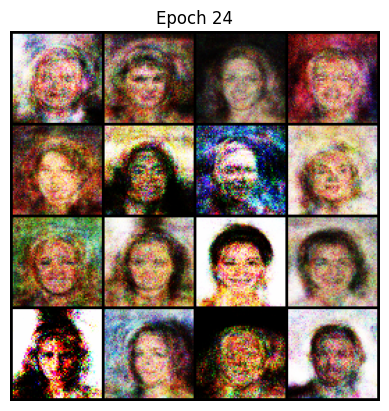

[Epoch 25/50] [Batch 0/3166] [D loss: 0.5707] [G loss: 1.2388]
[Epoch 25/50] [Batch 50/3166] [D loss: 0.5671] [G loss: 1.2146]
[Epoch 25/50] [Batch 100/3166] [D loss: 0.5541] [G loss: 1.2621]
[Epoch 25/50] [Batch 150/3166] [D loss: 0.5677] [G loss: 1.1134]
[Epoch 25/50] [Batch 200/3166] [D loss: 0.5543] [G loss: 1.0885]
[Epoch 25/50] [Batch 250/3166] [D loss: 0.5859] [G loss: 1.2117]
[Epoch 25/50] [Batch 300/3166] [D loss: 0.6420] [G loss: 1.2255]
[Epoch 25/50] [Batch 350/3166] [D loss: 0.5515] [G loss: 1.0810]
[Epoch 25/50] [Batch 400/3166] [D loss: 0.5721] [G loss: 1.4127]
[Epoch 25/50] [Batch 450/3166] [D loss: 0.5846] [G loss: 0.9878]
[Epoch 25/50] [Batch 500/3166] [D loss: 0.5686] [G loss: 1.1884]
[Epoch 25/50] [Batch 550/3166] [D loss: 0.5087] [G loss: 1.1808]
[Epoch 25/50] [Batch 600/3166] [D loss: 0.5984] [G loss: 0.9774]
[Epoch 25/50] [Batch 650/3166] [D loss: 0.5330] [G loss: 1.1435]
[Epoch 25/50] [Batch 700/3166] [D loss: 0.5736] [G loss: 1.1508]
[Epoch 25/50] [Batch 750/316

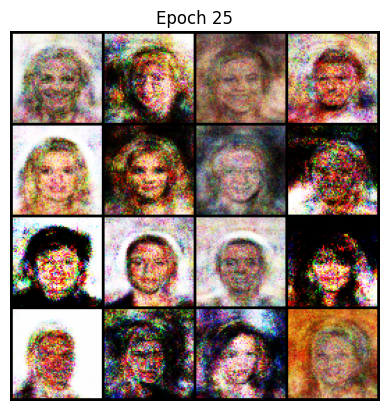

[Epoch 26/50] [Batch 0/3166] [D loss: 0.5872] [G loss: 1.2047]
[Epoch 26/50] [Batch 50/3166] [D loss: 0.5518] [G loss: 1.2869]
[Epoch 26/50] [Batch 100/3166] [D loss: 0.5274] [G loss: 1.1959]
[Epoch 26/50] [Batch 150/3166] [D loss: 0.6138] [G loss: 1.1978]
[Epoch 26/50] [Batch 200/3166] [D loss: 0.5261] [G loss: 1.1849]
[Epoch 26/50] [Batch 250/3166] [D loss: 0.4655] [G loss: 1.3554]
[Epoch 26/50] [Batch 300/3166] [D loss: 0.5670] [G loss: 1.0172]
[Epoch 26/50] [Batch 350/3166] [D loss: 0.5486] [G loss: 1.1814]
[Epoch 26/50] [Batch 400/3166] [D loss: 0.4908] [G loss: 1.3318]
[Epoch 26/50] [Batch 450/3166] [D loss: 0.5835] [G loss: 1.2866]
[Epoch 26/50] [Batch 500/3166] [D loss: 0.5491] [G loss: 1.0512]
[Epoch 26/50] [Batch 550/3166] [D loss: 0.5699] [G loss: 1.0636]
[Epoch 26/50] [Batch 600/3166] [D loss: 0.5263] [G loss: 1.2620]
[Epoch 26/50] [Batch 650/3166] [D loss: 0.5050] [G loss: 1.1630]
[Epoch 26/50] [Batch 700/3166] [D loss: 0.5260] [G loss: 1.2388]
[Epoch 26/50] [Batch 750/316

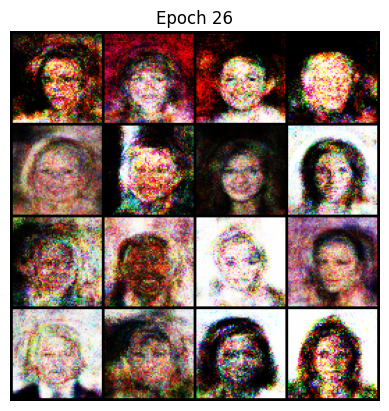

[Epoch 27/50] [Batch 0/3166] [D loss: 0.4567] [G loss: 1.3411]
[Epoch 27/50] [Batch 50/3166] [D loss: 0.6102] [G loss: 1.3849]
[Epoch 27/50] [Batch 100/3166] [D loss: 0.5155] [G loss: 1.1831]
[Epoch 27/50] [Batch 150/3166] [D loss: 0.4833] [G loss: 1.4044]
[Epoch 27/50] [Batch 200/3166] [D loss: 0.5854] [G loss: 1.1491]
[Epoch 27/50] [Batch 250/3166] [D loss: 0.4903] [G loss: 1.2241]
[Epoch 27/50] [Batch 300/3166] [D loss: 0.5235] [G loss: 1.0334]
[Epoch 27/50] [Batch 350/3166] [D loss: 0.5475] [G loss: 1.4869]
[Epoch 27/50] [Batch 400/3166] [D loss: 0.5173] [G loss: 1.3338]
[Epoch 27/50] [Batch 450/3166] [D loss: 0.4927] [G loss: 1.1514]
[Epoch 27/50] [Batch 500/3166] [D loss: 0.5904] [G loss: 1.1408]
[Epoch 27/50] [Batch 550/3166] [D loss: 0.6030] [G loss: 1.1229]
[Epoch 27/50] [Batch 600/3166] [D loss: 0.5522] [G loss: 1.0412]
[Epoch 27/50] [Batch 650/3166] [D loss: 0.4656] [G loss: 1.1444]
[Epoch 27/50] [Batch 700/3166] [D loss: 0.5484] [G loss: 1.1156]
[Epoch 27/50] [Batch 750/316

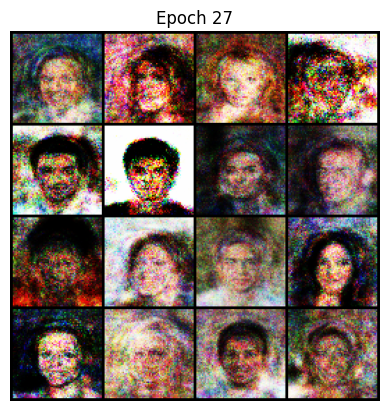

[Epoch 28/50] [Batch 0/3166] [D loss: 0.5887] [G loss: 1.3081]
[Epoch 28/50] [Batch 50/3166] [D loss: 0.5360] [G loss: 1.0121]
[Epoch 28/50] [Batch 100/3166] [D loss: 0.6614] [G loss: 1.1607]
[Epoch 28/50] [Batch 150/3166] [D loss: 0.5711] [G loss: 1.1165]
[Epoch 28/50] [Batch 200/3166] [D loss: 0.5198] [G loss: 1.1702]
[Epoch 28/50] [Batch 250/3166] [D loss: 0.5554] [G loss: 1.1210]
[Epoch 28/50] [Batch 300/3166] [D loss: 0.5716] [G loss: 1.1317]
[Epoch 28/50] [Batch 350/3166] [D loss: 0.5005] [G loss: 1.2467]
[Epoch 28/50] [Batch 400/3166] [D loss: 0.4832] [G loss: 1.1452]
[Epoch 28/50] [Batch 450/3166] [D loss: 0.5306] [G loss: 1.2182]
[Epoch 28/50] [Batch 500/3166] [D loss: 0.5819] [G loss: 1.1893]
[Epoch 28/50] [Batch 550/3166] [D loss: 0.5879] [G loss: 1.3168]
[Epoch 28/50] [Batch 600/3166] [D loss: 0.5534] [G loss: 1.2363]
[Epoch 28/50] [Batch 650/3166] [D loss: 0.5729] [G loss: 1.2495]
[Epoch 28/50] [Batch 700/3166] [D loss: 0.5166] [G loss: 1.0460]
[Epoch 28/50] [Batch 750/316

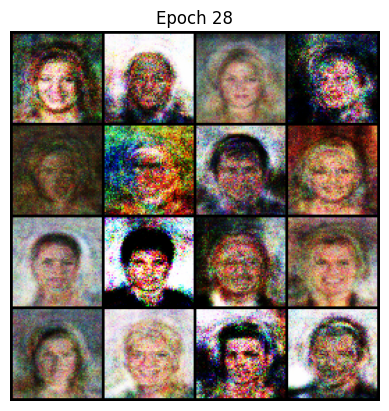

[Epoch 29/50] [Batch 0/3166] [D loss: 0.5356] [G loss: 1.5185]
[Epoch 29/50] [Batch 50/3166] [D loss: 0.5281] [G loss: 1.4202]
[Epoch 29/50] [Batch 100/3166] [D loss: 0.6215] [G loss: 0.9986]
[Epoch 29/50] [Batch 150/3166] [D loss: 0.5697] [G loss: 1.2610]
[Epoch 29/50] [Batch 200/3166] [D loss: 0.5674] [G loss: 1.0223]
[Epoch 29/50] [Batch 250/3166] [D loss: 0.6722] [G loss: 1.3429]
[Epoch 29/50] [Batch 300/3166] [D loss: 0.5434] [G loss: 1.3812]
[Epoch 29/50] [Batch 350/3166] [D loss: 0.5592] [G loss: 1.1897]
[Epoch 29/50] [Batch 400/3166] [D loss: 0.5272] [G loss: 1.1393]
[Epoch 29/50] [Batch 450/3166] [D loss: 0.5682] [G loss: 1.1866]
[Epoch 29/50] [Batch 500/3166] [D loss: 0.5507] [G loss: 1.3764]
[Epoch 29/50] [Batch 550/3166] [D loss: 0.5501] [G loss: 1.2835]
[Epoch 29/50] [Batch 600/3166] [D loss: 0.5008] [G loss: 1.2710]
[Epoch 29/50] [Batch 650/3166] [D loss: 0.5506] [G loss: 1.1033]
[Epoch 29/50] [Batch 700/3166] [D loss: 0.5737] [G loss: 1.1363]
[Epoch 29/50] [Batch 750/316

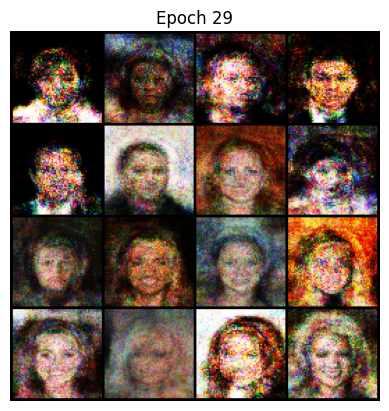

[Epoch 30/50] [Batch 0/3166] [D loss: 0.5116] [G loss: 1.1770]
[Epoch 30/50] [Batch 50/3166] [D loss: 0.5777] [G loss: 1.1172]
[Epoch 30/50] [Batch 100/3166] [D loss: 0.5879] [G loss: 1.1508]
[Epoch 30/50] [Batch 150/3166] [D loss: 0.5658] [G loss: 1.0935]
[Epoch 30/50] [Batch 200/3166] [D loss: 0.6419] [G loss: 1.1784]
[Epoch 30/50] [Batch 250/3166] [D loss: 0.5784] [G loss: 1.2287]
[Epoch 30/50] [Batch 300/3166] [D loss: 0.6397] [G loss: 1.0939]
[Epoch 30/50] [Batch 350/3166] [D loss: 0.4880] [G loss: 1.3060]
[Epoch 30/50] [Batch 400/3166] [D loss: 0.5431] [G loss: 1.4959]
[Epoch 30/50] [Batch 450/3166] [D loss: 0.5648] [G loss: 1.1301]
[Epoch 30/50] [Batch 500/3166] [D loss: 0.5929] [G loss: 1.3274]
[Epoch 30/50] [Batch 550/3166] [D loss: 0.6180] [G loss: 1.1277]
[Epoch 30/50] [Batch 600/3166] [D loss: 0.6067] [G loss: 1.2646]
[Epoch 30/50] [Batch 650/3166] [D loss: 0.5441] [G loss: 1.1886]
[Epoch 30/50] [Batch 700/3166] [D loss: 0.4939] [G loss: 1.2281]
[Epoch 30/50] [Batch 750/316

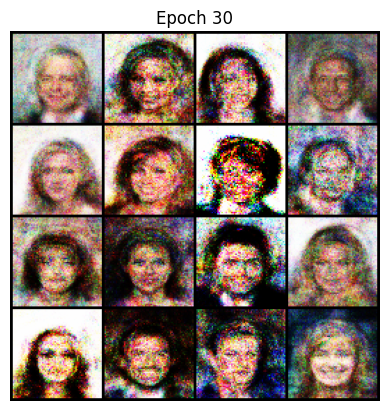

[Epoch 31/50] [Batch 0/3166] [D loss: 0.4883] [G loss: 1.2461]
[Epoch 31/50] [Batch 50/3166] [D loss: 0.5919] [G loss: 1.2060]
[Epoch 31/50] [Batch 100/3166] [D loss: 0.6281] [G loss: 1.3458]
[Epoch 31/50] [Batch 150/3166] [D loss: 0.5852] [G loss: 1.0725]
[Epoch 31/50] [Batch 200/3166] [D loss: 0.5568] [G loss: 1.2790]
[Epoch 31/50] [Batch 250/3166] [D loss: 0.5535] [G loss: 1.1813]
[Epoch 31/50] [Batch 300/3166] [D loss: 0.5918] [G loss: 0.9940]
[Epoch 31/50] [Batch 350/3166] [D loss: 0.5692] [G loss: 1.4105]
[Epoch 31/50] [Batch 400/3166] [D loss: 0.5279] [G loss: 0.8896]
[Epoch 31/50] [Batch 450/3166] [D loss: 0.5646] [G loss: 1.2781]
[Epoch 31/50] [Batch 500/3166] [D loss: 0.4643] [G loss: 1.3681]
[Epoch 31/50] [Batch 550/3166] [D loss: 0.5970] [G loss: 1.2237]
[Epoch 31/50] [Batch 600/3166] [D loss: 0.5264] [G loss: 1.1367]
[Epoch 31/50] [Batch 650/3166] [D loss: 0.6148] [G loss: 1.3573]
[Epoch 31/50] [Batch 700/3166] [D loss: 0.5406] [G loss: 1.0947]
[Epoch 31/50] [Batch 750/316

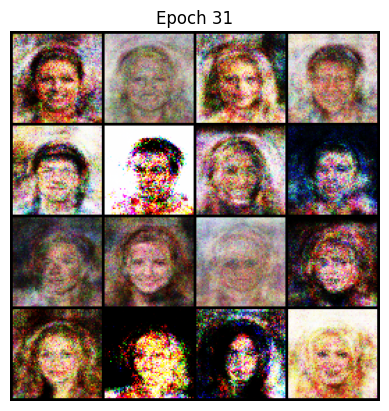

[Epoch 32/50] [Batch 0/3166] [D loss: 0.5962] [G loss: 1.1942]
[Epoch 32/50] [Batch 50/3166] [D loss: 0.5185] [G loss: 1.2610]
[Epoch 32/50] [Batch 100/3166] [D loss: 0.5639] [G loss: 1.1313]
[Epoch 32/50] [Batch 150/3166] [D loss: 0.5290] [G loss: 1.1350]
[Epoch 32/50] [Batch 200/3166] [D loss: 0.6461] [G loss: 1.1356]
[Epoch 32/50] [Batch 250/3166] [D loss: 0.5814] [G loss: 1.1330]
[Epoch 32/50] [Batch 300/3166] [D loss: 0.5756] [G loss: 1.3979]
[Epoch 32/50] [Batch 350/3166] [D loss: 0.5977] [G loss: 1.1062]
[Epoch 32/50] [Batch 400/3166] [D loss: 0.6288] [G loss: 1.3488]
[Epoch 32/50] [Batch 450/3166] [D loss: 0.5569] [G loss: 1.2563]
[Epoch 32/50] [Batch 500/3166] [D loss: 0.5808] [G loss: 1.1808]
[Epoch 32/50] [Batch 550/3166] [D loss: 0.4659] [G loss: 1.0497]
[Epoch 32/50] [Batch 600/3166] [D loss: 0.5878] [G loss: 1.4623]
[Epoch 32/50] [Batch 650/3166] [D loss: 0.5232] [G loss: 1.1702]
[Epoch 32/50] [Batch 700/3166] [D loss: 0.5238] [G loss: 1.2187]
[Epoch 32/50] [Batch 750/316

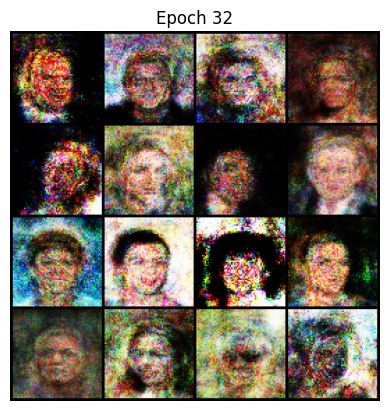

[Epoch 33/50] [Batch 0/3166] [D loss: 0.5499] [G loss: 1.1265]
[Epoch 33/50] [Batch 50/3166] [D loss: 0.5832] [G loss: 1.2647]
[Epoch 33/50] [Batch 100/3166] [D loss: 0.5262] [G loss: 1.1608]
[Epoch 33/50] [Batch 150/3166] [D loss: 0.5151] [G loss: 1.1930]
[Epoch 33/50] [Batch 200/3166] [D loss: 0.5558] [G loss: 1.1181]
[Epoch 33/50] [Batch 250/3166] [D loss: 0.5745] [G loss: 1.1615]
[Epoch 33/50] [Batch 300/3166] [D loss: 0.5177] [G loss: 1.4363]
[Epoch 33/50] [Batch 350/3166] [D loss: 0.5276] [G loss: 1.1639]
[Epoch 33/50] [Batch 400/3166] [D loss: 0.5409] [G loss: 1.2262]
[Epoch 33/50] [Batch 450/3166] [D loss: 0.4779] [G loss: 1.2350]
[Epoch 33/50] [Batch 500/3166] [D loss: 0.5631] [G loss: 1.1009]
[Epoch 33/50] [Batch 550/3166] [D loss: 0.7781] [G loss: 1.3207]
[Epoch 33/50] [Batch 600/3166] [D loss: 0.4911] [G loss: 1.1766]
[Epoch 33/50] [Batch 650/3166] [D loss: 0.4999] [G loss: 1.1695]
[Epoch 33/50] [Batch 700/3166] [D loss: 0.4582] [G loss: 1.3954]
[Epoch 33/50] [Batch 750/316

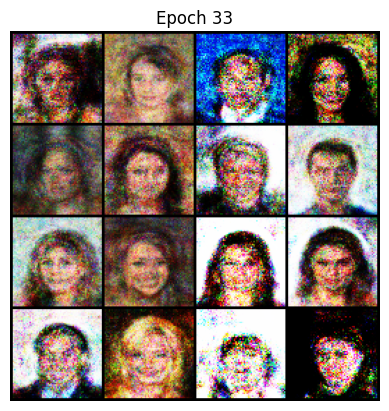

[Epoch 34/50] [Batch 0/3166] [D loss: 0.6064] [G loss: 1.1784]
[Epoch 34/50] [Batch 50/3166] [D loss: 0.5289] [G loss: 1.3272]
[Epoch 34/50] [Batch 100/3166] [D loss: 0.5411] [G loss: 1.3796]
[Epoch 34/50] [Batch 150/3166] [D loss: 0.5790] [G loss: 1.2999]
[Epoch 34/50] [Batch 200/3166] [D loss: 0.4589] [G loss: 1.2490]
[Epoch 34/50] [Batch 250/3166] [D loss: 0.5835] [G loss: 0.9992]
[Epoch 34/50] [Batch 300/3166] [D loss: 0.6653] [G loss: 1.2884]
[Epoch 34/50] [Batch 350/3166] [D loss: 0.6145] [G loss: 1.1730]
[Epoch 34/50] [Batch 400/3166] [D loss: 0.4834] [G loss: 1.2987]
[Epoch 34/50] [Batch 450/3166] [D loss: 0.6799] [G loss: 1.2974]
[Epoch 34/50] [Batch 500/3166] [D loss: 0.5578] [G loss: 1.0983]
[Epoch 34/50] [Batch 550/3166] [D loss: 0.6258] [G loss: 1.4595]
[Epoch 34/50] [Batch 600/3166] [D loss: 0.6530] [G loss: 1.1330]
[Epoch 34/50] [Batch 650/3166] [D loss: 0.5479] [G loss: 1.2358]
[Epoch 34/50] [Batch 700/3166] [D loss: 0.4452] [G loss: 1.1543]
[Epoch 34/50] [Batch 750/316

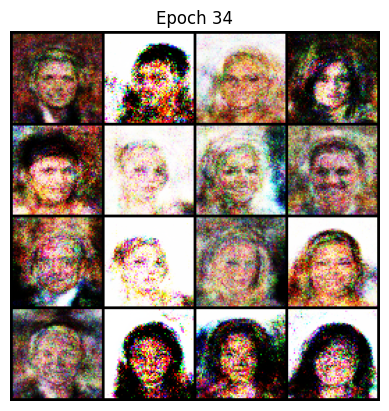

[Epoch 35/50] [Batch 0/3166] [D loss: 0.5354] [G loss: 1.1592]
[Epoch 35/50] [Batch 50/3166] [D loss: 0.5227] [G loss: 1.2087]
[Epoch 35/50] [Batch 100/3166] [D loss: 0.5850] [G loss: 1.3657]
[Epoch 35/50] [Batch 150/3166] [D loss: 0.6348] [G loss: 1.1625]
[Epoch 35/50] [Batch 200/3166] [D loss: 0.5610] [G loss: 0.9609]
[Epoch 35/50] [Batch 250/3166] [D loss: 0.5575] [G loss: 1.2846]
[Epoch 35/50] [Batch 300/3166] [D loss: 0.5025] [G loss: 1.3939]
[Epoch 35/50] [Batch 350/3166] [D loss: 0.5508] [G loss: 1.2643]
[Epoch 35/50] [Batch 400/3166] [D loss: 0.5394] [G loss: 1.3484]
[Epoch 35/50] [Batch 450/3166] [D loss: 0.5665] [G loss: 1.3945]
[Epoch 35/50] [Batch 500/3166] [D loss: 0.4744] [G loss: 1.1174]
[Epoch 35/50] [Batch 550/3166] [D loss: 0.5246] [G loss: 1.3027]
[Epoch 35/50] [Batch 600/3166] [D loss: 0.6038] [G loss: 1.2369]
[Epoch 35/50] [Batch 650/3166] [D loss: 0.5012] [G loss: 1.2896]
[Epoch 35/50] [Batch 700/3166] [D loss: 0.5238] [G loss: 1.1621]
[Epoch 35/50] [Batch 750/316

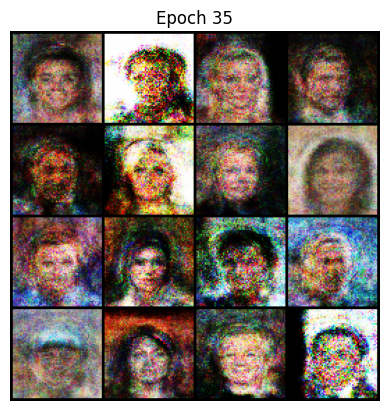

[Epoch 36/50] [Batch 0/3166] [D loss: 0.5345] [G loss: 1.3038]
[Epoch 36/50] [Batch 50/3166] [D loss: 0.5023] [G loss: 1.0880]
[Epoch 36/50] [Batch 100/3166] [D loss: 0.6048] [G loss: 1.2482]
[Epoch 36/50] [Batch 150/3166] [D loss: 0.5091] [G loss: 1.2301]
[Epoch 36/50] [Batch 200/3166] [D loss: 0.4930] [G loss: 1.3532]
[Epoch 36/50] [Batch 250/3166] [D loss: 0.5687] [G loss: 1.1501]
[Epoch 36/50] [Batch 300/3166] [D loss: 0.6269] [G loss: 1.2369]
[Epoch 36/50] [Batch 350/3166] [D loss: 0.4824] [G loss: 1.2258]
[Epoch 36/50] [Batch 400/3166] [D loss: 0.5452] [G loss: 1.2300]
[Epoch 36/50] [Batch 450/3166] [D loss: 0.5111] [G loss: 1.0299]
[Epoch 36/50] [Batch 500/3166] [D loss: 0.5547] [G loss: 1.1723]
[Epoch 36/50] [Batch 550/3166] [D loss: 0.7102] [G loss: 1.2189]
[Epoch 36/50] [Batch 600/3166] [D loss: 0.5020] [G loss: 1.2326]
[Epoch 36/50] [Batch 650/3166] [D loss: 0.5526] [G loss: 1.0558]
[Epoch 36/50] [Batch 700/3166] [D loss: 0.5414] [G loss: 1.1589]
[Epoch 36/50] [Batch 750/316

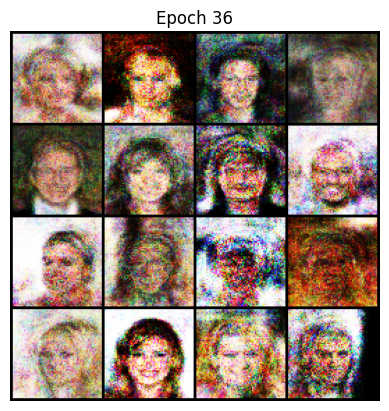

[Epoch 37/50] [Batch 0/3166] [D loss: 0.4483] [G loss: 1.2363]
[Epoch 37/50] [Batch 50/3166] [D loss: 0.5287] [G loss: 1.3069]
[Epoch 37/50] [Batch 100/3166] [D loss: 0.5730] [G loss: 1.2807]
[Epoch 37/50] [Batch 150/3166] [D loss: 0.6047] [G loss: 1.1324]
[Epoch 37/50] [Batch 200/3166] [D loss: 0.4527] [G loss: 1.5326]
[Epoch 37/50] [Batch 250/3166] [D loss: 0.5170] [G loss: 1.2675]
[Epoch 37/50] [Batch 300/3166] [D loss: 0.5622] [G loss: 1.3257]
[Epoch 37/50] [Batch 350/3166] [D loss: 0.5861] [G loss: 1.2149]
[Epoch 37/50] [Batch 400/3166] [D loss: 0.5746] [G loss: 1.2699]
[Epoch 37/50] [Batch 450/3166] [D loss: 0.5136] [G loss: 1.2060]
[Epoch 37/50] [Batch 500/3166] [D loss: 0.5171] [G loss: 1.2297]
[Epoch 37/50] [Batch 550/3166] [D loss: 0.5489] [G loss: 1.1397]
[Epoch 37/50] [Batch 600/3166] [D loss: 0.5047] [G loss: 1.5736]
[Epoch 37/50] [Batch 650/3166] [D loss: 0.5739] [G loss: 1.1234]
[Epoch 37/50] [Batch 700/3166] [D loss: 0.5927] [G loss: 1.0332]
[Epoch 37/50] [Batch 750/316

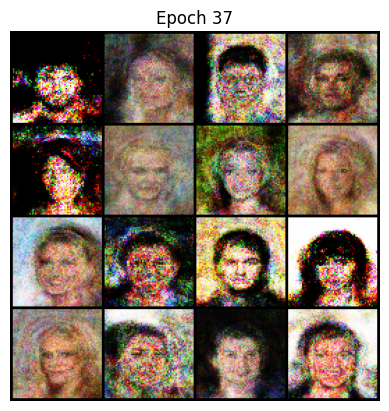

[Epoch 38/50] [Batch 0/3166] [D loss: 0.5228] [G loss: 1.2566]
[Epoch 38/50] [Batch 50/3166] [D loss: 0.4802] [G loss: 1.2053]
[Epoch 38/50] [Batch 100/3166] [D loss: 0.4904] [G loss: 1.1328]
[Epoch 38/50] [Batch 150/3166] [D loss: 0.4723] [G loss: 1.2932]
[Epoch 38/50] [Batch 200/3166] [D loss: 0.5638] [G loss: 1.1797]
[Epoch 38/50] [Batch 250/3166] [D loss: 0.5415] [G loss: 1.1552]
[Epoch 38/50] [Batch 300/3166] [D loss: 0.6085] [G loss: 1.2115]
[Epoch 38/50] [Batch 350/3166] [D loss: 0.5594] [G loss: 1.1296]
[Epoch 38/50] [Batch 400/3166] [D loss: 0.4943] [G loss: 1.2321]
[Epoch 38/50] [Batch 450/3166] [D loss: 0.5882] [G loss: 1.2275]
[Epoch 38/50] [Batch 500/3166] [D loss: 0.5714] [G loss: 1.2741]
[Epoch 38/50] [Batch 550/3166] [D loss: 0.5937] [G loss: 1.4955]
[Epoch 38/50] [Batch 600/3166] [D loss: 0.5441] [G loss: 1.1319]
[Epoch 38/50] [Batch 650/3166] [D loss: 0.5137] [G loss: 1.1181]
[Epoch 38/50] [Batch 700/3166] [D loss: 0.4955] [G loss: 1.4873]
[Epoch 38/50] [Batch 750/316

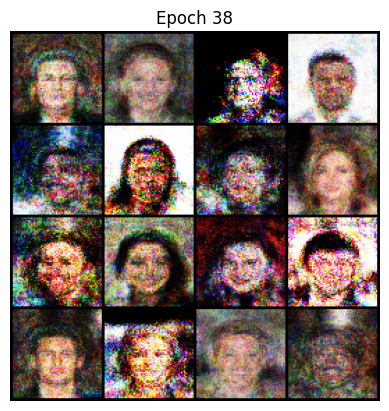

[Epoch 39/50] [Batch 0/3166] [D loss: 0.4983] [G loss: 1.1208]
[Epoch 39/50] [Batch 50/3166] [D loss: 0.4888] [G loss: 1.5201]
[Epoch 39/50] [Batch 100/3166] [D loss: 0.5862] [G loss: 1.2590]
[Epoch 39/50] [Batch 150/3166] [D loss: 0.4550] [G loss: 1.0454]
[Epoch 39/50] [Batch 200/3166] [D loss: 0.4979] [G loss: 1.1778]
[Epoch 39/50] [Batch 250/3166] [D loss: 0.5274] [G loss: 1.2752]
[Epoch 39/50] [Batch 300/3166] [D loss: 0.4432] [G loss: 1.6161]
[Epoch 39/50] [Batch 350/3166] [D loss: 0.5017] [G loss: 1.4117]
[Epoch 39/50] [Batch 400/3166] [D loss: 0.5141] [G loss: 1.4661]
[Epoch 39/50] [Batch 450/3166] [D loss: 0.4515] [G loss: 1.1545]
[Epoch 39/50] [Batch 500/3166] [D loss: 0.5664] [G loss: 1.2607]
[Epoch 39/50] [Batch 550/3166] [D loss: 0.5905] [G loss: 1.0475]
[Epoch 39/50] [Batch 600/3166] [D loss: 0.5760] [G loss: 1.4127]
[Epoch 39/50] [Batch 650/3166] [D loss: 0.5199] [G loss: 1.1551]
[Epoch 39/50] [Batch 700/3166] [D loss: 0.6143] [G loss: 1.2694]
[Epoch 39/50] [Batch 750/316

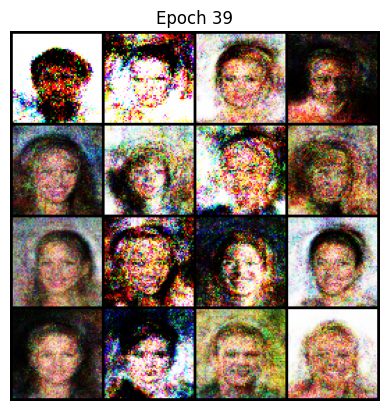

[Epoch 40/50] [Batch 0/3166] [D loss: 0.5254] [G loss: 1.0971]
[Epoch 40/50] [Batch 50/3166] [D loss: 0.4752] [G loss: 1.1382]
[Epoch 40/50] [Batch 100/3166] [D loss: 0.5466] [G loss: 1.0901]
[Epoch 40/50] [Batch 150/3166] [D loss: 0.5199] [G loss: 1.3119]
[Epoch 40/50] [Batch 200/3166] [D loss: 0.4942] [G loss: 1.3044]
[Epoch 40/50] [Batch 250/3166] [D loss: 0.5819] [G loss: 1.3317]
[Epoch 40/50] [Batch 300/3166] [D loss: 0.5637] [G loss: 1.4973]
[Epoch 40/50] [Batch 350/3166] [D loss: 0.6046] [G loss: 1.4993]
[Epoch 40/50] [Batch 400/3166] [D loss: 0.5348] [G loss: 1.2379]
[Epoch 40/50] [Batch 450/3166] [D loss: 0.5640] [G loss: 1.1731]
[Epoch 40/50] [Batch 500/3166] [D loss: 0.5881] [G loss: 1.2351]
[Epoch 40/50] [Batch 550/3166] [D loss: 0.5159] [G loss: 1.4767]
[Epoch 40/50] [Batch 600/3166] [D loss: 0.4777] [G loss: 1.3401]
[Epoch 40/50] [Batch 650/3166] [D loss: 0.5579] [G loss: 1.0229]
[Epoch 40/50] [Batch 700/3166] [D loss: 0.4986] [G loss: 1.0512]
[Epoch 40/50] [Batch 750/316

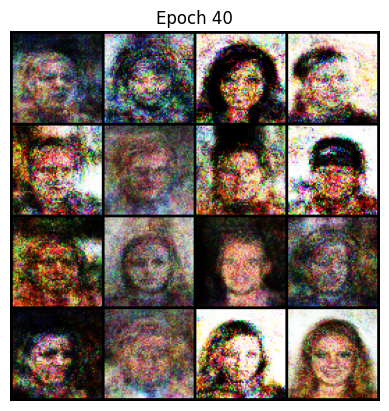

[Epoch 41/50] [Batch 0/3166] [D loss: 0.6370] [G loss: 1.1288]
[Epoch 41/50] [Batch 50/3166] [D loss: 0.4611] [G loss: 1.0967]
[Epoch 41/50] [Batch 100/3166] [D loss: 0.5112] [G loss: 1.2686]
[Epoch 41/50] [Batch 150/3166] [D loss: 0.5168] [G loss: 1.7079]
[Epoch 41/50] [Batch 200/3166] [D loss: 0.5249] [G loss: 1.2694]
[Epoch 41/50] [Batch 250/3166] [D loss: 0.4746] [G loss: 1.4742]
[Epoch 41/50] [Batch 300/3166] [D loss: 0.6206] [G loss: 1.2443]
[Epoch 41/50] [Batch 350/3166] [D loss: 0.5900] [G loss: 1.2104]
[Epoch 41/50] [Batch 400/3166] [D loss: 0.6050] [G loss: 1.3075]
[Epoch 41/50] [Batch 450/3166] [D loss: 0.5661] [G loss: 1.3349]
[Epoch 41/50] [Batch 500/3166] [D loss: 0.5192] [G loss: 1.3872]
[Epoch 41/50] [Batch 550/3166] [D loss: 0.5536] [G loss: 1.2719]
[Epoch 41/50] [Batch 600/3166] [D loss: 0.5617] [G loss: 1.3803]
[Epoch 41/50] [Batch 650/3166] [D loss: 0.5417] [G loss: 1.3464]
[Epoch 41/50] [Batch 700/3166] [D loss: 0.5302] [G loss: 1.2958]
[Epoch 41/50] [Batch 750/316

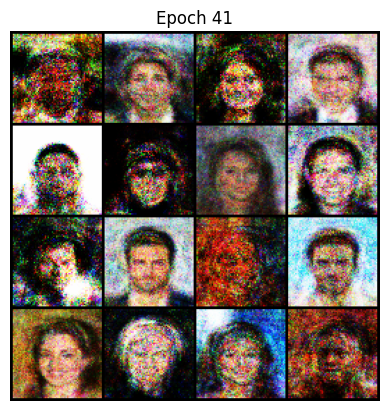

[Epoch 42/50] [Batch 0/3166] [D loss: 0.5729] [G loss: 1.2408]
[Epoch 42/50] [Batch 50/3166] [D loss: 0.4678] [G loss: 1.4487]
[Epoch 42/50] [Batch 100/3166] [D loss: 0.5233] [G loss: 1.3921]
[Epoch 42/50] [Batch 150/3166] [D loss: 0.4169] [G loss: 1.4442]
[Epoch 42/50] [Batch 200/3166] [D loss: 0.5975] [G loss: 1.3987]
[Epoch 42/50] [Batch 250/3166] [D loss: 0.5283] [G loss: 1.0562]
[Epoch 42/50] [Batch 300/3166] [D loss: 0.5569] [G loss: 1.3021]
[Epoch 42/50] [Batch 350/3166] [D loss: 0.5045] [G loss: 1.2885]
[Epoch 42/50] [Batch 400/3166] [D loss: 0.5241] [G loss: 1.1967]
[Epoch 42/50] [Batch 450/3166] [D loss: 0.6218] [G loss: 1.2584]
[Epoch 42/50] [Batch 500/3166] [D loss: 0.5363] [G loss: 1.4463]
[Epoch 42/50] [Batch 550/3166] [D loss: 0.7637] [G loss: 1.1512]
[Epoch 42/50] [Batch 600/3166] [D loss: 0.4630] [G loss: 1.2999]
[Epoch 42/50] [Batch 650/3166] [D loss: 0.5809] [G loss: 1.0012]
[Epoch 42/50] [Batch 700/3166] [D loss: 0.5532] [G loss: 1.3278]
[Epoch 42/50] [Batch 750/316

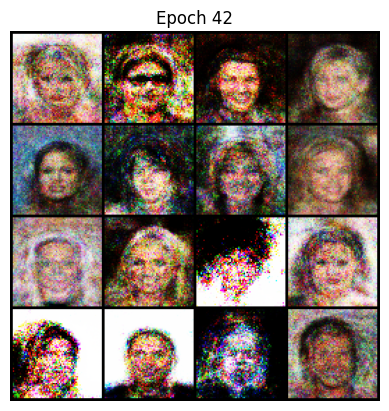

[Epoch 43/50] [Batch 0/3166] [D loss: 0.5264] [G loss: 1.5008]
[Epoch 43/50] [Batch 50/3166] [D loss: 0.5950] [G loss: 1.3213]
[Epoch 43/50] [Batch 100/3166] [D loss: 0.5584] [G loss: 1.3125]
[Epoch 43/50] [Batch 150/3166] [D loss: 0.5100] [G loss: 1.5010]
[Epoch 43/50] [Batch 200/3166] [D loss: 0.5328] [G loss: 1.4062]
[Epoch 43/50] [Batch 250/3166] [D loss: 0.5360] [G loss: 1.5020]
[Epoch 43/50] [Batch 300/3166] [D loss: 0.5379] [G loss: 1.1651]
[Epoch 43/50] [Batch 350/3166] [D loss: 0.5021] [G loss: 1.1486]
[Epoch 43/50] [Batch 400/3166] [D loss: 0.5054] [G loss: 1.4277]
[Epoch 43/50] [Batch 450/3166] [D loss: 0.5536] [G loss: 1.1413]
[Epoch 43/50] [Batch 500/3166] [D loss: 0.4430] [G loss: 1.3266]
[Epoch 43/50] [Batch 550/3166] [D loss: 0.4717] [G loss: 1.2620]
[Epoch 43/50] [Batch 600/3166] [D loss: 0.5537] [G loss: 1.0351]
[Epoch 43/50] [Batch 650/3166] [D loss: 0.5328] [G loss: 1.3893]
[Epoch 43/50] [Batch 700/3166] [D loss: 0.5780] [G loss: 1.1823]
[Epoch 43/50] [Batch 750/316

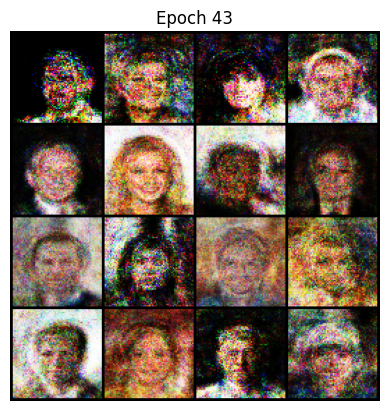

[Epoch 44/50] [Batch 0/3166] [D loss: 0.4433] [G loss: 1.2179]
[Epoch 44/50] [Batch 50/3166] [D loss: 0.5697] [G loss: 1.2641]
[Epoch 44/50] [Batch 100/3166] [D loss: 0.5596] [G loss: 1.2844]
[Epoch 44/50] [Batch 150/3166] [D loss: 0.4971] [G loss: 1.3686]
[Epoch 44/50] [Batch 200/3166] [D loss: 0.4935] [G loss: 1.3308]
[Epoch 44/50] [Batch 250/3166] [D loss: 0.5114] [G loss: 1.4423]
[Epoch 44/50] [Batch 300/3166] [D loss: 0.5350] [G loss: 1.5259]
[Epoch 44/50] [Batch 350/3166] [D loss: 0.5633] [G loss: 1.1932]
[Epoch 44/50] [Batch 400/3166] [D loss: 0.5429] [G loss: 1.2397]
[Epoch 44/50] [Batch 450/3166] [D loss: 0.5351] [G loss: 1.3792]
[Epoch 44/50] [Batch 500/3166] [D loss: 0.5153] [G loss: 1.5532]
[Epoch 44/50] [Batch 550/3166] [D loss: 0.6236] [G loss: 1.3170]
[Epoch 44/50] [Batch 600/3166] [D loss: 0.5935] [G loss: 1.2953]
[Epoch 44/50] [Batch 650/3166] [D loss: 0.5742] [G loss: 1.3496]
[Epoch 44/50] [Batch 700/3166] [D loss: 0.4549] [G loss: 1.3278]
[Epoch 44/50] [Batch 750/316

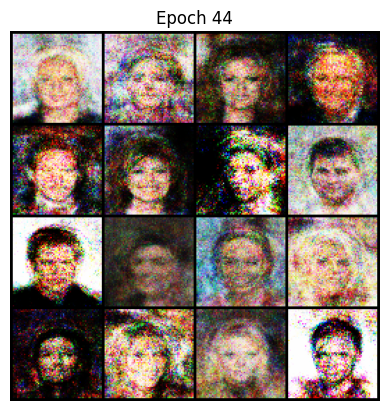

[Epoch 45/50] [Batch 0/3166] [D loss: 0.4821] [G loss: 1.2319]
[Epoch 45/50] [Batch 50/3166] [D loss: 0.5166] [G loss: 1.3739]
[Epoch 45/50] [Batch 100/3166] [D loss: 0.6030] [G loss: 1.3856]
[Epoch 45/50] [Batch 150/3166] [D loss: 0.5550] [G loss: 1.2157]
[Epoch 45/50] [Batch 200/3166] [D loss: 0.5050] [G loss: 1.1895]
[Epoch 45/50] [Batch 250/3166] [D loss: 0.5092] [G loss: 1.2944]
[Epoch 45/50] [Batch 300/3166] [D loss: 0.4741] [G loss: 1.3951]
[Epoch 45/50] [Batch 350/3166] [D loss: 0.4656] [G loss: 1.5487]
[Epoch 45/50] [Batch 400/3166] [D loss: 0.6358] [G loss: 1.5486]
[Epoch 45/50] [Batch 450/3166] [D loss: 0.4964] [G loss: 1.3561]
[Epoch 45/50] [Batch 500/3166] [D loss: 0.4827] [G loss: 1.1989]
[Epoch 45/50] [Batch 600/3166] [D loss: 0.6593] [G loss: 1.2612]
[Epoch 45/50] [Batch 650/3166] [D loss: 0.4911] [G loss: 1.1872]
[Epoch 45/50] [Batch 700/3166] [D loss: 0.4698] [G loss: 1.2695]
[Epoch 45/50] [Batch 750/3166] [D loss: 0.5155] [G loss: 1.1779]
[Epoch 45/50] [Batch 800/316

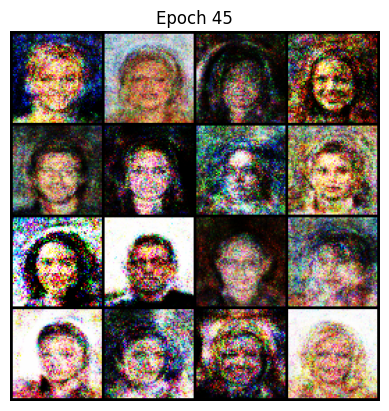

[Epoch 46/50] [Batch 0/3166] [D loss: 0.4468] [G loss: 1.3483]
[Epoch 46/50] [Batch 50/3166] [D loss: 0.4290] [G loss: 1.3252]
[Epoch 46/50] [Batch 100/3166] [D loss: 0.4825] [G loss: 1.1192]
[Epoch 46/50] [Batch 150/3166] [D loss: 0.4912] [G loss: 1.4187]
[Epoch 46/50] [Batch 200/3166] [D loss: 0.4565] [G loss: 1.0867]
[Epoch 46/50] [Batch 250/3166] [D loss: 0.4941] [G loss: 1.1928]
[Epoch 46/50] [Batch 300/3166] [D loss: 0.5496] [G loss: 1.1901]
[Epoch 46/50] [Batch 350/3166] [D loss: 0.6060] [G loss: 1.2869]
[Epoch 46/50] [Batch 400/3166] [D loss: 0.4731] [G loss: 1.2728]
[Epoch 46/50] [Batch 450/3166] [D loss: 0.5741] [G loss: 1.3283]
[Epoch 46/50] [Batch 500/3166] [D loss: 0.5289] [G loss: 1.2689]
[Epoch 46/50] [Batch 550/3166] [D loss: 0.5855] [G loss: 1.4476]
[Epoch 46/50] [Batch 600/3166] [D loss: 0.5893] [G loss: 1.1626]
[Epoch 46/50] [Batch 650/3166] [D loss: 0.6148] [G loss: 1.3440]
[Epoch 46/50] [Batch 700/3166] [D loss: 0.5217] [G loss: 1.1628]
[Epoch 46/50] [Batch 750/316

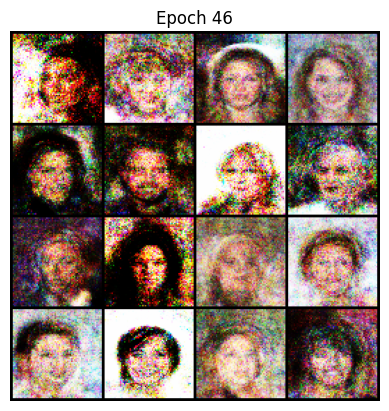

[Epoch 47/50] [Batch 0/3166] [D loss: 0.5932] [G loss: 1.2902]
[Epoch 47/50] [Batch 50/3166] [D loss: 0.5450] [G loss: 1.2937]
[Epoch 47/50] [Batch 100/3166] [D loss: 0.5027] [G loss: 1.3309]
[Epoch 47/50] [Batch 150/3166] [D loss: 0.6030] [G loss: 1.3549]
[Epoch 47/50] [Batch 200/3166] [D loss: 0.4873] [G loss: 1.2573]
[Epoch 47/50] [Batch 250/3166] [D loss: 0.5621] [G loss: 1.0643]
[Epoch 47/50] [Batch 300/3166] [D loss: 0.6326] [G loss: 1.3857]
[Epoch 47/50] [Batch 350/3166] [D loss: 0.4562] [G loss: 1.6446]
[Epoch 47/50] [Batch 400/3166] [D loss: 0.4963] [G loss: 1.2637]
[Epoch 47/50] [Batch 450/3166] [D loss: 0.5335] [G loss: 1.6896]
[Epoch 47/50] [Batch 500/3166] [D loss: 0.4847] [G loss: 1.3990]
[Epoch 47/50] [Batch 550/3166] [D loss: 0.5985] [G loss: 1.0642]
[Epoch 47/50] [Batch 600/3166] [D loss: 0.5603] [G loss: 1.0561]
[Epoch 47/50] [Batch 650/3166] [D loss: 0.4080] [G loss: 1.1701]
[Epoch 47/50] [Batch 700/3166] [D loss: 0.5565] [G loss: 1.3576]
[Epoch 47/50] [Batch 750/316

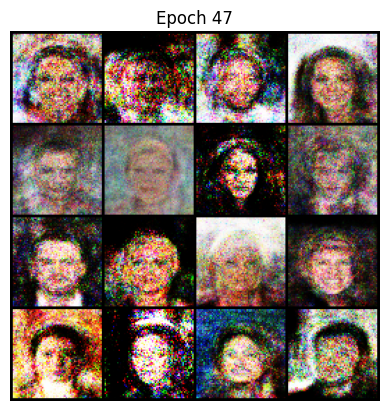

[Epoch 48/50] [Batch 0/3166] [D loss: 0.4422] [G loss: 1.2611]
[Epoch 48/50] [Batch 50/3166] [D loss: 0.5472] [G loss: 1.3002]
[Epoch 48/50] [Batch 100/3166] [D loss: 0.5034] [G loss: 1.2997]
[Epoch 48/50] [Batch 150/3166] [D loss: 0.5803] [G loss: 1.2337]
[Epoch 48/50] [Batch 200/3166] [D loss: 0.5542] [G loss: 1.2771]
[Epoch 48/50] [Batch 250/3166] [D loss: 0.4838] [G loss: 1.2566]
[Epoch 48/50] [Batch 300/3166] [D loss: 0.4817] [G loss: 1.2062]
[Epoch 48/50] [Batch 350/3166] [D loss: 0.4542] [G loss: 1.2149]
[Epoch 48/50] [Batch 400/3166] [D loss: 0.5626] [G loss: 1.3104]
[Epoch 48/50] [Batch 450/3166] [D loss: 0.4319] [G loss: 1.5896]
[Epoch 48/50] [Batch 500/3166] [D loss: 0.6306] [G loss: 1.3712]
[Epoch 48/50] [Batch 550/3166] [D loss: 0.4443] [G loss: 1.5055]
[Epoch 48/50] [Batch 600/3166] [D loss: 0.5268] [G loss: 1.3981]
[Epoch 48/50] [Batch 650/3166] [D loss: 0.5284] [G loss: 1.4994]
[Epoch 48/50] [Batch 700/3166] [D loss: 0.5110] [G loss: 1.2522]
[Epoch 48/50] [Batch 750/316

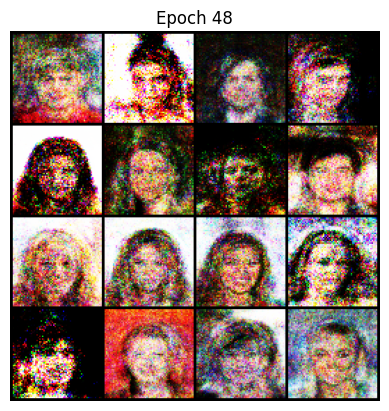

[Epoch 49/50] [Batch 0/3166] [D loss: 0.5117] [G loss: 1.6413]
[Epoch 49/50] [Batch 50/3166] [D loss: 0.5277] [G loss: 1.0963]
[Epoch 49/50] [Batch 100/3166] [D loss: 0.5924] [G loss: 1.2640]
[Epoch 49/50] [Batch 150/3166] [D loss: 0.5455] [G loss: 1.1684]
[Epoch 49/50] [Batch 200/3166] [D loss: 0.5185] [G loss: 1.1702]
[Epoch 49/50] [Batch 250/3166] [D loss: 0.4907] [G loss: 1.3781]
[Epoch 49/50] [Batch 300/3166] [D loss: 0.5526] [G loss: 1.5476]
[Epoch 49/50] [Batch 350/3166] [D loss: 0.4899] [G loss: 1.4633]
[Epoch 49/50] [Batch 400/3166] [D loss: 0.5427] [G loss: 1.3954]
[Epoch 49/50] [Batch 450/3166] [D loss: 0.5357] [G loss: 1.1495]
[Epoch 49/50] [Batch 500/3166] [D loss: 0.5233] [G loss: 1.3331]
[Epoch 49/50] [Batch 550/3166] [D loss: 0.5262] [G loss: 1.1474]
[Epoch 49/50] [Batch 600/3166] [D loss: 0.5261] [G loss: 1.2915]
[Epoch 49/50] [Batch 650/3166] [D loss: 0.5564] [G loss: 1.1294]
[Epoch 49/50] [Batch 700/3166] [D loss: 0.5476] [G loss: 1.4680]
[Epoch 49/50] [Batch 750/316

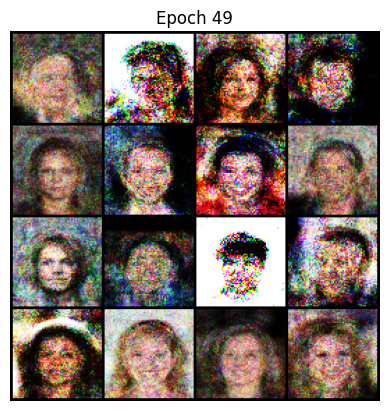

In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import matplotlib.pyplot as plt
import os
from PIL import Image
import torchvision
import numpy as np

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class Generator(nn.Module):
    def __init__(self, z_dim=100, img_channels=3):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(z_dim, 256),
            nn.ReLU(True),
            nn.Linear(256, 512),
            nn.ReLU(True),
            nn.Linear(512, 1024),
            nn.ReLU(True),
            nn.Linear(1024, img_channels * 64 * 64),
            nn.Tanh()
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(z.size(0), 3, 64, 64)
        return img

class Discriminator(nn.Module):
    def __init__(self, img_channels=3):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Flatten(),
            nn.Linear(img_channels * 64 * 64, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img):
        return self.model(img)

generator = Generator().to(device)
discriminator = Discriminator().to(device)

adversarial_loss = nn.BCELoss()
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

class CustomDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.image_paths = [os.path.join(root_dir, img) for img in os.listdir(root_dir) if img.endswith('.png') or img.endswith('.jpg')]
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img = Image.open(self.image_paths[idx]).convert('RGB')
        if self.transform:
            img = self.transform(img)
        return img

dataset = CustomDataset(root_dir="/kaggle/input/celebrity-image-dataset/img_align_celeba", transform=transform)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

def train(generator, discriminator, dataloader, epochs=5):
    for epoch in range(epochs):
        for i, imgs in enumerate(dataloader):
            real_imgs = imgs.to(device)
            batch_size = real_imgs.size(0)
            valid = torch.ones(batch_size, 1, device=device)
            fake = torch.zeros(batch_size, 1, device=device)

            optimizer_D.zero_grad()
            z = torch.randn(batch_size, 100, device=device)
            fake_imgs = generator(z).detach()
            real_loss = adversarial_loss(discriminator(real_imgs), valid)
            fake_loss = adversarial_loss(discriminator(fake_imgs), fake)
            d_loss = (real_loss + fake_loss) / 2
            d_loss.backward()
            optimizer_D.step()

            optimizer_G.zero_grad()
            z = torch.randn(batch_size, 100, device=device)
            gen_imgs = generator(z)
            g_loss = adversarial_loss(discriminator(gen_imgs), valid)
            g_loss.backward()
            optimizer_G.step()

            if i % 50 == 0:
                print(f"[Epoch {epoch}/{epochs}] [Batch {i}/{len(dataloader)}] [D loss: {d_loss.item():.4f}] [G loss: {g_loss.item():.4f}]")

        save_generated_images(generator, epoch)

def save_generated_images(generator, epoch, num_images=16):
    z = torch.randn(num_images, 100, device=device)
    generated_imgs = generator(z).detach().cpu()
    grid = torchvision.utils.make_grid(generated_imgs, nrow=4, normalize=True)
    plt.imshow(np.transpose(grid, (1, 2, 0)))
    plt.title(f"Epoch {epoch}")
    plt.axis('off')
    plt.show()

train(generator, discriminator, dataloader, epochs=50)


In [26]:
def generate_one_face(generator):
    generator.eval()  # Set to eval mode
    with torch.no_grad():
        z = torch.randn(1, 100, device=device)  # Generate 1 random noise vector
        generated_img = generator(z).detach().cpu().squeeze(0)  # Generate image
        img = torchvision.utils.make_grid(generated_img, normalize=True)
        plt.imshow(np.transpose(img, (1, 2, 0)))
        plt.title("Randomly Generated Face")
        plt.axis('off')
        plt.show()


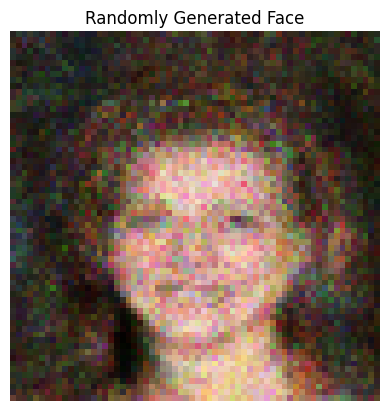

In [27]:
generate_one_face(generator)


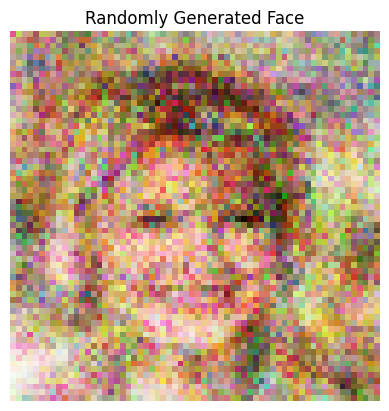

In [49]:
generate_one_face(generator)


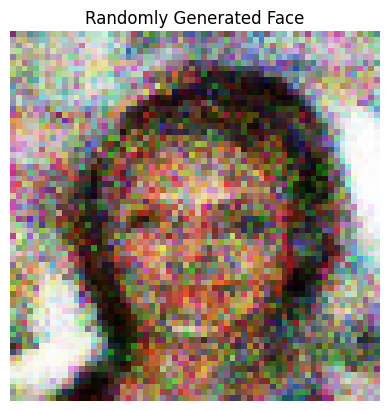

In [51]:
generate_one_face(generator)


In [12]:
# The images are blur because the pixel size was 64 

# This whole notebook took 12 hours to run hence due to resource 
# contrain the images are like this 


# just increase the img size to more resol. and batch size more 
# to get HD images .

In [ ]:
# Warning this is too much GPU intensive and can lead to OS crash
# Dont run in your PC direclty if you have no GPU or MX series Nvidia 
# nor kernal crash can make OS unstable and can result in funny and unwanted behaviour in Windows 